# Run an SVD Analysis on Western US Snotel Sites

In [1]:
import numpy as np
import os
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.axes_divider import make_axes_locatable
import contextily as ctx
import ulmo
import datetime as dt
from datetime import datetime
from shapely.geometry import Point
import metloom
from metloom.pointdata import CDECPointData
from metloom.pointdata import SnotelPointData
from metloom.variables import CdecStationVariables
import pickle
import scipy.stats as stats
# SVD function from scipy
from scipy.linalg import svd
import sklearn
from sklearn.cluster import KMeans

### Read in US States file and make Western US files:

In [25]:
# # Load and read USA state polygons:
# states_url = 'http://eric.clst.org/assets/wiki/uploads/Stuff/gz_2010_us_040_00_5m.json'
# states_gdf_orig = gpd.read_file(states_url)

# # Create Washington State polygon:
# washington = states_gdf_orig.loc[states_gdf_orig.NAME == 'Washington'].to_crs('epsg:32610')

# # Create CONUS polygon:
# #conus = states_gdf_orig.loc[(states_gdf_orig['NAME'] != 'Alaska') & 
#         #(states_gdf_orig['NAME'] != 'Hawaii') & (states_gdf_orig['NAME'] != 'Puerto Rico')]

# # List all Western states:
# state_list = ['Washington', 'Oregon', 'California', 'Idaho', 'Montana', 
#               'Wyoming', 'Utah', 'Arizona', 'Nevada', 'Colorado', 'New Mexico']

# # Select only Western States:
# western_states_32612 = states_gdf_orig.loc[states_gdf_orig['NAME'].isin(state_list)].to_crs('epsg:32612')
# western_boundary = western_states_32612.dissolve()

# # Save files:
# #western_boundary.to_file('../data/western_boundary.geojson', driver='GeoJSON')
# #western_states_32612.to_file('../data/western_states.shp')

### Read in data that was created in the above cell:

<Axes: >

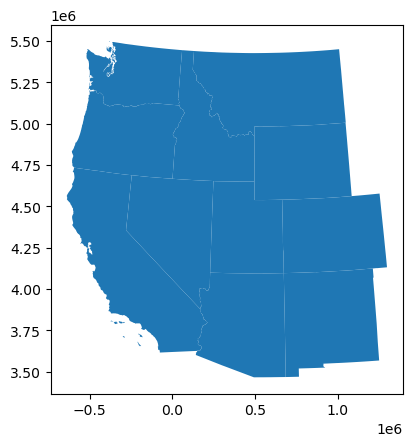

In [2]:
wstates = gpd.read_file('../data/misc/western_states.shp')
wstates_4326=wstates.to_crs('epsg:4326')

wstates_boundary = gpd.read_file('../data/misc/western_boundary.geojson')

wstates.plot()

### Use CUAHSI to download location and elevation information about all snotel sites

In [3]:
wsdlurl = 'https://hydroportal.cuahsi.org/Snotel/cuahsi_1_1.asmx?WSDL'
#sites = ulmo.cuahsi.wof.get_sites(wsdlurl)

In [7]:
# # the warning this throws is only avoidable by upgrading to the newest version of Shapely. The output is correct.

# sites_df = pd.DataFrame.from_dict(sites, orient='index').dropna()
# sites_df['geometry'] = [Point(float(loc['longitude']), float(loc['latitude'])) for loc in sites_df['location']]

# sites_df = sites_df.drop(columns='location')
# sites_df = sites_df.astype({"elevation_m":float})

# sites_gdf = gpd.GeoDataFrame(sites_df, crs='EPSG:4326', geometry=sites_df['geometry'])
# # Subset sites to lower 48
# western_snotel = sites_gdf.overlay(wstates_4326, how='intersection')

In [15]:
# # Save the snotel locations file:
# fn = '../data/western_snotel_locations.pkl'

# with open(fn, 'wb') as f:
#     pickle.dump(western_snotel, f)

In [4]:
western_snotel = pickle.load(open('../data/snotel/western_snotel_locations.pkl', 'rb'))

### Map all the sites in the Western US

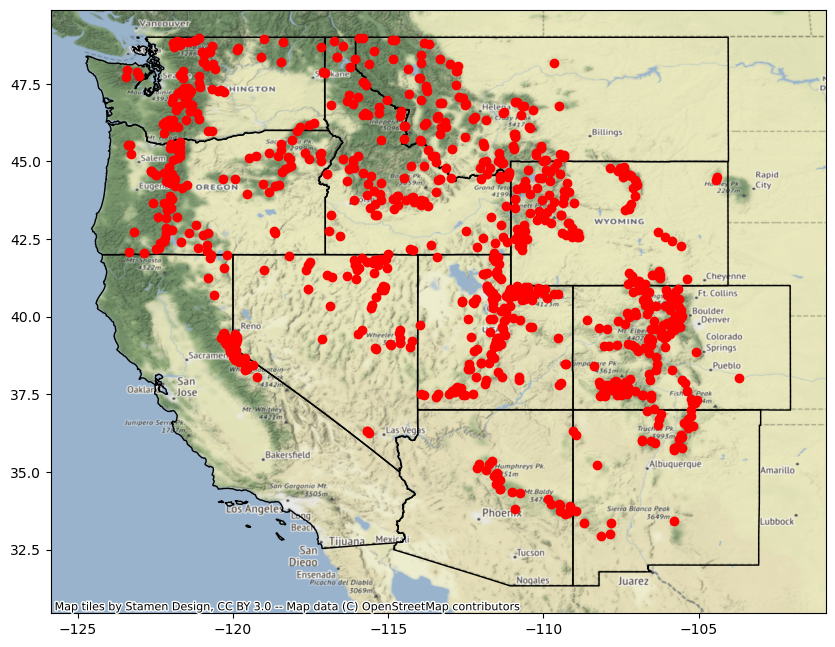

In [25]:
# Lower 48 snotel sites

fig, ax = plt.subplots(figsize=(10,10))

wstates_4326.plot(ax=ax, facecolor='none')
western_snotel.plot(ax=ax, c='red')

ctx.add_basemap(ax=ax, crs='epsg:4326', source=ctx.providers.Stamen.Terrain);


In [14]:
# site_codes = []
# for i in range(len(western_snotel)):
#     site_codes.append(western_snotel.index[i])
    
# #Use corresponding colors in line and location scatterplots
# color_list = ['C%i' % i for i in range(len(site_codes))]

# len(site_codes)

859

### Download daily snow depth for each snotel site

In [12]:
# from metloom.pointdata import SnotelPointData
# #from metloom.variables import SnotelStationVariables

# snotel_points = SnotelPointData.points_from_geometry(wstates_boundary, 
#                                                     SnotelStationVariables.SNOWDEPTH,
#                                                     snow_courses=False)
# snotel_locations = snotel_points.to_dataframe()
# snotel_locations = snotel_locations.set_crs('espg:4326')
# snotel_locations.head()

In [ ]:
# from datetime import datetime
# from metloom.pointdata import SnotelPointData

# snotel_point = SnotelPointData("713:CO:SNTL", "MyStation")
# df = snotel_point.get_daily_data(
#     datetime(2020, 1, 2), datetime(2020, 1, 20),
#     [snotel_point.ALLOWED_VARIABLES.SWE]
# )
# print(df)

In [ ]:
# snotel_locations = snotel_points.get_daily_data(
#     datetime(2005, 3, 1), datetime(2023, 5, 1),
#     [snotel_point.ALLOWED_VARIABLES.SWE]
# )

In [5]:
# Function from David Shean, as supplied during GDA course through UW offered in Winter 2021

#Get current datetime
today = datetime.today().strftime('%Y-%m-%d')

def fetch(sitecode, variablecode='SNOTEL:SNWD_D', start_date='1980-10-01', end_date=today):
    #print(sitecode, variablecode, start_date, end_date)
    values_df = None
    try:
        #Request data from the server
        site_values = ulmo.cuahsi.wof.get_values(wsdlurl, sitecode, variablecode, start=start_date, end=end_date)
        #Convert to a Pandas DataFrame   
        values_df = pd.DataFrame.from_dict(site_values['values'])
        #Parse the datetime values to Pandas Timestamp objects
        values_df['datetime'] = pd.to_datetime(values_df['datetime'], utc=True)
        #Set the DataFrame index to the Timestamps
        values_df = values_df.set_index('datetime')
        #Convert values to float and replace -9999 nodata values with NaN
        values_df['value'] = pd.to_numeric(values_df['value']).replace(-9999, np.nan)
        #Remove any records flagged with lower quality
        values_df = values_df[values_df['quality_control_level_code'] == '1']
    except:
        print("Unable to fetch %s" % variablecode)

    return values_df

In [6]:
start_date = datetime(1980,10,1)
end_date = datetime.today()

#Daily snow depth
variablecode = 'SNOTEL:SNWD_D'

In [7]:
western_snotel.index = western_snotel.code
western_snotel.head(2)

,code,name,network,elevation_m,site_property,GEO_ID,STATE,NAME,LSAD,CENSUSAREA,geometry
code,,,,,,,,,,,
301_CA_SNTL,301_CA_SNTL,Adin Mtn,SNOTEL,1886.712036,"{'county': 'Modoc', 'state': 'California', 'si...",0400000US06,06,California,NaN,155779.22,POINT (-120.79192 41.23583)
356_CA_SNTL,356_CA_SNTL,Blue Lakes,SNOTEL,2458.821533,"{'county': 'Alpine', 'state': 'California', 's...",0400000US06,06,California,NaN,155779.22,POINT (-119.92437 38.60800)


In [8]:

pkl_fn = '../data/snotel/snotel_snwd.pkl'
gdf = western_snotel

if os.path.exists(pkl_fn):
    snwd_df = pd.read_pickle(pkl_fn)
else:
    #Define an empty dictionary to store returns for each site
    value_dict = {}
    for i, sitecode in enumerate(gdf.index):
        print('%i of %i sites' % (i+1, len(gdf.index)) )
        #out = fetch(sitecode, variablecode, start_date, end_date)
        out = fetch(sitecode, variablecode)
        if out is not None:
            value_dict[sitecode] = out['value']
    #Convert the dictionary to a DataFrame, automatically handles different datetime ranges (nice!)
    snwd_df = pd.DataFrame.from_dict(value_dict)
    # Hannah Added: to rename columns so they match the code names for the site list
    # for column in snwd_df.columns:
    #     snwd_df = snwd_df.rename(columns={column:(':'.join(column.split(':')[1:]))})
    #Write out
    print(f"Writing out: {pkl_fn}")
    snwd_df.to_pickle(pkl_fn)

In [25]:
# for column in snwd_df.columns:
#     snwd_df = snwd_df.rename(columns={column:(':'.join(column.split(':')[1:]))})

> the problem here is that the sites list has more entries than the actual data, due to issues with data not being available at all locations. So I need to remove sites from the site list that don't exist in the snow depth data. 

### Create a new dataframe containing only the snow depth on April 1 at each site:

In [9]:
snwd_april1 = snwd_df.loc[snwd_df.index.month == 4] 
snwd_april1 = snwd_april1.loc[snwd_april1.index.day == 1]

### Calculate the Anomalies: Difference from the temporal April 1 mean for each year.

In [10]:
snwd_april1_anom = snwd_april1 - np.nanmean(snwd_april1, axis=0)

### Calculate the Percent Anomolies for each year on April 1

In [53]:
# snwd_april1_anom_percent = (snwd_april1_anom / np.nanmean(snwd_april1, axis=0)) * 100
# snwd_april1_anom_percent.head(2)

,301_CA_SNTL,356_CA_SNTL,1051_CA_SNTL,1067_CA_SNTL,391_CA_SNTL,977_CA_SNTL,428_CA_SNTL,446_CA_SNTL,462_CA_SNTL,463_CA_SNTL,...,1194_NV_SNTL,811_NV_SNTL,1202_NV_SNTL,1136_NV_SNTL,1137_NV_SNTL,849_NV_SNTL,1147_NV_SNTL,1213_NV_SNTL,354_SD_SNTL,920_SD_SNTL
datetime,,,,,,,,,,,,,,,,,,,,,
1994-04-01 00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1995-04-01 00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1996-04-01 00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1997-04-01 00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1998-04-01 00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1999-04-01 00:00:00+00:00,110.101010,42.318059,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,-2.661597,NaN,NaN,NaN,NaN
2000-04-01 00:00:00+00:00,9.090909,3.504043,NaN,NaN,NaN,-100.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,21.673004,NaN,NaN,NaN,NaN
2001-04-01 00:00:00+00:00,-59.595960,-33.692722,NaN,NaN,NaN,-100.0,NaN,NaN,-36.951220,NaN,...,NaN,NaN,NaN,NaN,NaN,-11.787072,NaN,NaN,NaN,NaN
2002-04-01 00:00:00+00:00,29.292929,1.886792,NaN,NaN,NaN,-100.0,NaN,NaN,-0.731707,NaN,...,NaN,NaN,NaN,NaN,NaN,-17.870722,NaN,NaN,NaN,NaN


## Finish Data Cleaning and Conduct the SVD Analaysis  
The SVD function does not accept NaN values, so we need to remove years and sites that result in NaN values: we need to find a balance between number of years and number of sites.

### Recheck this with the new data, from 2005 to 2023 to accomodate the CDEC data

In [94]:
#snwd_april1.isnull().sum(axis=1)

In [17]:
snwd_april1_2000 = snwd_april1.loc[(snwd_april1.index >= '2000-04-01')]
snwd_april1_2000 = snwd_april1_2000.dropna(axis=1)

snwd_april1_2001 = snwd_april1.loc[(snwd_april1.index >= '2001-04-01')]
snwd_april1_2001 = snwd_april1_2001.dropna(axis=1)

snwd_april1_2002 = snwd_april1.loc[(snwd_april1.index >= '2002-04-01')]
snwd_april1_2002 = snwd_april1_2002.dropna(axis=1)

snwd_april1_2003 = snwd_april1.loc[(snwd_april1.index >= '2003-04-01')]
snwd_april1_2003 = snwd_april1_2003.dropna(axis=1)

snwd_april1_2004 = snwd_april1.loc[(snwd_april1.index >= '2004-04-01')]
snwd_april1_2004 = snwd_april1_2004.dropna(axis=1)

snwd_april1_2005 = snwd_april1.loc[(snwd_april1.index >= '2005-04-01')]
snwd_april1_2005 = snwd_april1_2005.dropna(axis=1)

snwd_april1_2006 = snwd_april1.loc[(snwd_april1.index >= '2006-04-01')]
snwd_april1_2006 = snwd_april1_2006.dropna(axis=1)

snwd_april1_2007 = snwd_april1.loc[(snwd_april1.index >= '2007-04-01')]
snwd_april1_2007 = snwd_april1_2007.dropna(axis=1)

snwd_april1_2008 = snwd_april1.loc[(snwd_april1.index >= '2008-04-01')]
snwd_april1_2008 = snwd_april1_2008.dropna(axis=1)

snwd_april1_2009 = snwd_april1.loc[(snwd_april1.index >= '2009-04-01')]
snwd_april1_2009 = snwd_april1_2009.dropna(axis=1)

In [18]:
print(snwd_april1_2000.shape, ', ', snwd_april1_2000.size)
print(snwd_april1_2001.shape, ', ', snwd_april1_2001.size)
print(snwd_april1_2002.shape, ', ', snwd_april1_2002.size)
print(snwd_april1_2003.shape, ', ', snwd_april1_2003.size)
print(snwd_april1_2004.shape, ', ', snwd_april1_2004.size)
print(snwd_april1_2005.shape, ', ', snwd_april1_2005.size)
print(snwd_april1_2006.shape, ', ', snwd_april1_2006.size)
print(snwd_april1_2007.shape, ', ', snwd_april1_2007.size)
print(snwd_april1_2008.shape, ', ', snwd_april1_2008.size)
print(snwd_april1_2009.shape, ', ', snwd_april1_2009.size)

(24, 129) ,  3096
(23, 169) ,  3887
(22, 231) ,  5082
(21, 326) ,  6846
(20, 436) ,  8720
(19, 483) ,  9177
(18, 520) ,  9360
(17, 564) ,  9588
(16, 584) ,  9344
(15, 613) ,  9195


Looks like you gain approximately 100 sites per year, until 2008 when you get diminishing returns. I'm going to elliminate pre-2004 data to maximize data but keep a decently long record.

### Remove NaN values from snow depth and location data

In [12]:
snwd_april1_nan = snwd_april1.loc[(snwd_april1.index >= '2005-04-01')]
snwd_april1_nan = snwd_april1_nan.dropna(axis=1)
snwd_april1_anom_nan = snwd_april1_anom.loc[(snwd_april1_anom.index >= '2005-04-01')]
snwd_april1_anom_nan = snwd_april1_anom_nan.dropna(axis=1)

# Remove Western snotel site locations
western_snotel_nan = western_snotel.copy()

index_list = []
for x in snwd_april1_nan.columns:
    index_list.append(x)
    
x_list = []
for x in western_snotel_nan.code:
    x_list.append(x)
    
for i in x_list:
    if i not in index_list:
        western_snotel_nan = western_snotel_nan.drop([i])


In [52]:
!pwd

/Users/Hannah/Documents/Documents_Grad/Research/CorrelatedDomains/notebooks


In [13]:
#snwd_april1_nan[0:1].T

In [13]:
snwd_april1_anom_nan.to_pickle('../data/snotel/snotel_april1_anom.pkl')
western_snotel_nan.to_pickle('../data/snotel/western_snotel_nan.pkl')

In [149]:
dates = []
for x in combined_april1_anom.index:
    x = x.replace(tzinfo=None)
    dates.append(x)

TypeError: 'tzinfo' is an invalid keyword argument for replace()

In [150]:
combined_april1_anom.index

Index([2005-04-01, 2007-04-01, 2008-04-01, 2009-04-01, 2010-04-01, 2011-04-01,
       2012-04-01, 2013-04-01, 2014-04-01, 2015-04-01, 2016-04-01, 2017-04-01,
       2018-04-01, 2019-04-01, 2020-04-01, 2021-04-01, 2022-04-01, 2023-04-01],
      dtype='object')

In [39]:
dates

[datetime.datetime(2004, 4, 1, 0, 0),
 datetime.datetime(2005, 4, 1, 0, 0),
 datetime.datetime(2006, 4, 1, 0, 0),
 datetime.datetime(2007, 4, 1, 0, 0),
 datetime.datetime(2008, 4, 1, 0, 0),
 datetime.datetime(2009, 4, 1, 0, 0),
 datetime.datetime(2010, 4, 1, 0, 0),
 datetime.datetime(2011, 4, 1, 0, 0),
 datetime.datetime(2012, 4, 1, 0, 0),
 datetime.datetime(2013, 4, 1, 0, 0),
 datetime.datetime(2014, 4, 1, 0, 0),
 datetime.datetime(2015, 4, 1, 0, 0),
 datetime.datetime(2016, 4, 1, 0, 0),
 datetime.datetime(2017, 4, 1, 0, 0),
 datetime.datetime(2018, 4, 1, 0, 0),
 datetime.datetime(2019, 4, 1, 0, 0),
 datetime.datetime(2020, 4, 1, 0, 0),
 datetime.datetime(2021, 4, 1, 0, 0),
 datetime.datetime(2022, 4, 1, 0, 0)]

In [121]:
# Convert to an array for use in the svd function
snotel_april1_array = snwd_april1_anom_nan.to_numpy()
combined_april1_array = combined_april1_anom.to_numpy()

In [122]:
# Perform the SVD

U, S, V = svd(snotel_april1_array.T,full_matrices=False)
Uc, Sc, Vc = svd(combined_april1_array.T,full_matrices=False)

In [114]:
U.shape, S.shape, V.shape

((494, 18), (18,), (18, 18))

Text(0, 0.5, 'weight')

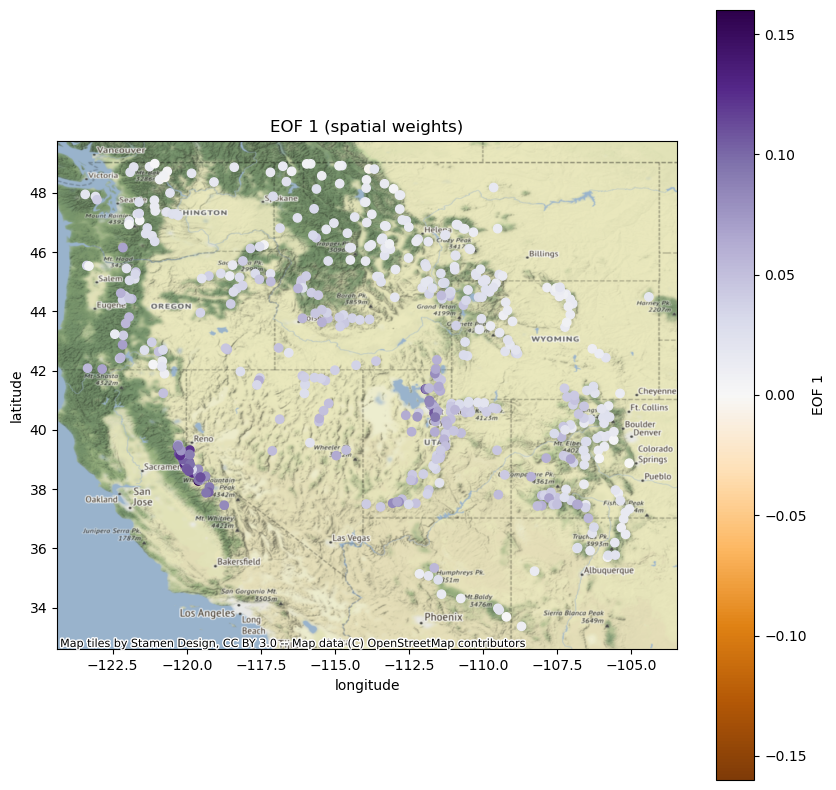

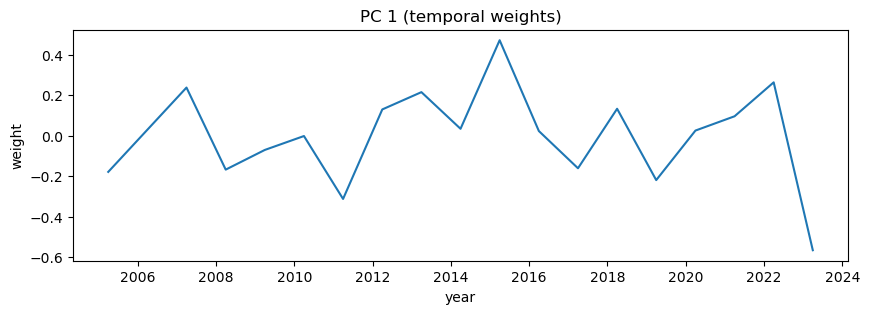

In [154]:
# first index for both U and V
i = 0
#station_locations[f'U{i}'] = Uc[:,i]
# plot first EOF (U)
fig, ax = plt.subplots(figsize=(10,10))
station_locations.plot(ax=ax, column=-1*Uc[:,i], legend=True, cmap='PuOr', legend_kwds={'label': "EOF 1",'orientation': "vertical"}, vmin=-0.16, vmax=0.16)
ctx.add_basemap(ax=ax, crs='epsg:4326', source=ctx.providers.Stamen.Terrain)
wstates.plot(ax=ax, facecolor='none', edgecolor='k')
plt.title('EOF 1 (spatial weights)');
plt.xlabel('longitude')
plt.ylabel('latitude')

#Plot first PC (V)
plt.figure(figsize=(10,3))
plt.plot(combined_april1_anom.index,Vc[i,:]);
plt.title('PC 1 (temporal weights)');
plt.xlabel('year')
plt.ylabel('weight')

Text(91.97222222222221, 0.5, 'latitude')

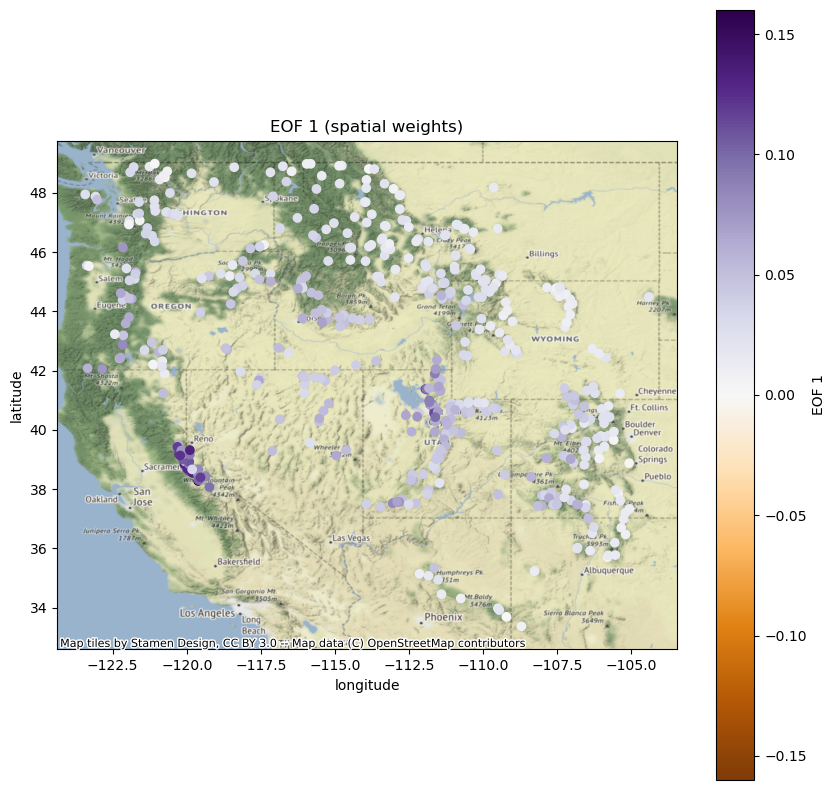

In [124]:
# first index for both U and V
i = 0
#western_snotel_nan['U1'] = U[:,i]
# plot first EOF (U)
fig, ax = plt.subplots(figsize=(10,10))
western_snotel_nan.plot(ax=ax, column=-1*U[:,i], legend=True, cmap='PuOr', legend_kwds={'label': "EOF 1",'orientation': "vertical"}, vmin=-0.16, vmax=0.16)
ctx.add_basemap(ax=ax, crs='epsg:4326', source=ctx.providers.Stamen.Terrain)
wstates.plot(ax=ax, facecolor='none', edgecolor='k')
plt.title('EOF 1 (spatial weights)');
plt.xlabel('longitude')
plt.ylabel('latitude')

#Plot first PC (V)
#plt.figure(figsize=(10,3))
#plt.plot(dates,V[i,:]);
#plt.title('PC 1 (temporal weights)');
#plt.xlabel('year')
#plt.ylabel('weight')

(36.0, 40.0)

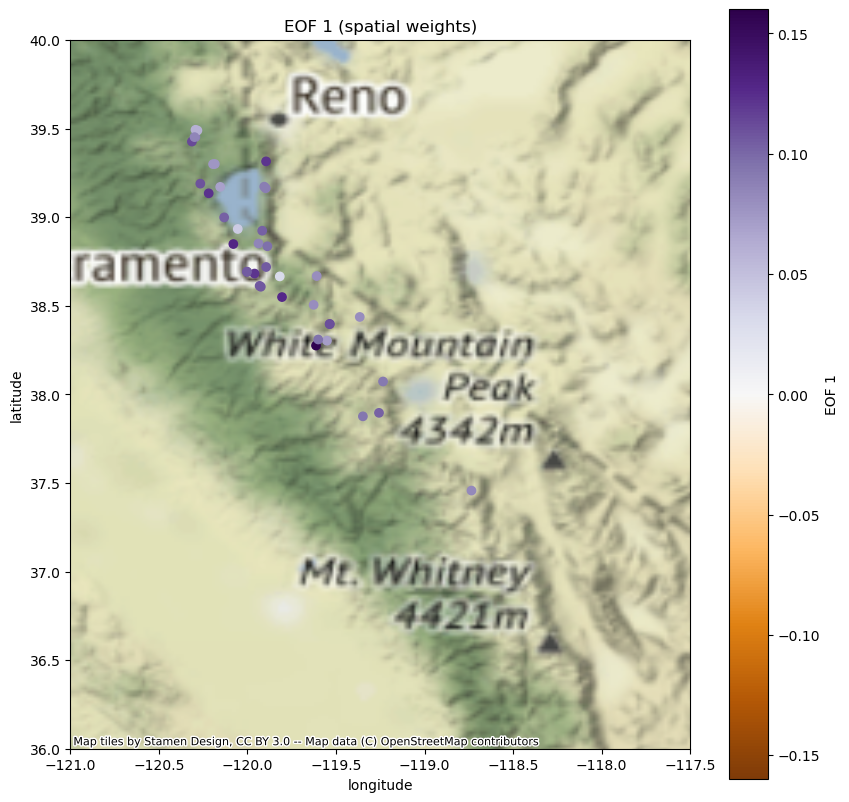

In [120]:
i = 0
#station_locations['U1'] = U[:,i]
# plot first EOF (U)
fig, ax = plt.subplots(figsize=(10,10))
station_locations.plot(ax=ax, column=-1*U[:,i], legend=True, cmap='PuOr', legend_kwds={'label': "EOF 1",'orientation': "vertical"}, vmin=-0.16, vmax=0.16)
ctx.add_basemap(ax=ax, crs='epsg:4326', source=ctx.providers.Stamen.Terrain)
wstates.plot(ax=ax, facecolor='none', edgecolor='k')
plt.title('EOF 1 (spatial weights)');
plt.xlabel('longitude')
plt.ylabel('latitude')
ax.set_xlim(-121,-117.5)
ax.set_ylim(36,40)

(36.0, 40.0)

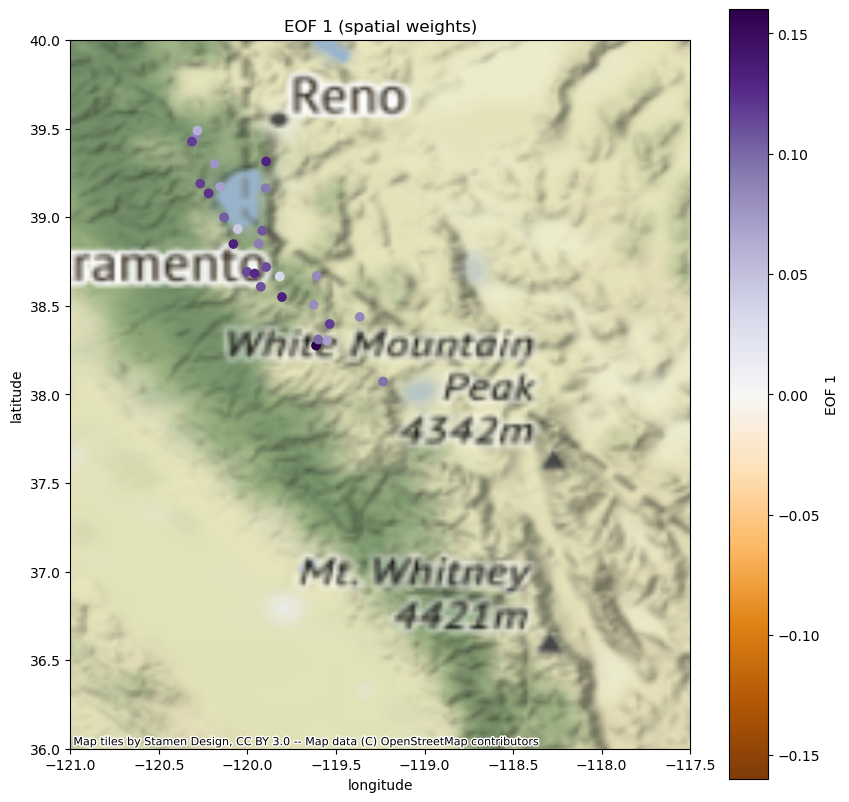

In [125]:
i = 0
#western_snotel_nan['U1'] = U[:,i]
# plot first EOF (U)
fig, ax = plt.subplots(figsize=(10,10))
western_snotel_nan.plot(ax=ax, column=-1*U[:,i], legend=True, cmap='PuOr', legend_kwds={'label': "EOF 1",'orientation': "vertical"}, vmin=-0.16, vmax=0.16)
ctx.add_basemap(ax=ax, crs='epsg:4326', source=ctx.providers.Stamen.Terrain)
wstates.plot(ax=ax, facecolor='none', edgecolor='k')
plt.title('EOF 1 (spatial weights)');
plt.xlabel('longitude')
plt.ylabel('latitude')
ax.set_xlim(-121,-117.5)
ax.set_ylim(36,40)

In [86]:
# Using both snotel and cdec
# first index for both U and V
i = 0
#western_snotel_nan['U1'] = U[:,i]
# plot first EOF (U)
fig, ax = plt.subplots(figsize=(10,10))
station_locations.plot(ax=ax, column='Ui', legend=True, cmap='PuOr', legend_kwds={'label': "EOF 1",'orientation': "vertical"}, vmin=-0.16, vmax=0.16)
ctx.add_basemap(ax=ax, crs='epsg:4326', source=ctx.providers.Stamen.Terrain)
western_states.plot(ax=ax, facecolor='none', edgecolor='k')
plt.title('EOF 1 (spatial weights)');
plt.xlabel('longitude')
plt.ylabel('latitude')

#Plot first PC (V)
plt.figure(figsize=(10,3))
plt.plot(dates,V[i,:]);
plt.title('PC 1 (temporal weights)');
plt.xlabel('year')
plt.ylabel('weight')

ValueError: Length of values (494) does not match length of index (483)

Text(0, 0.5, 'weight')

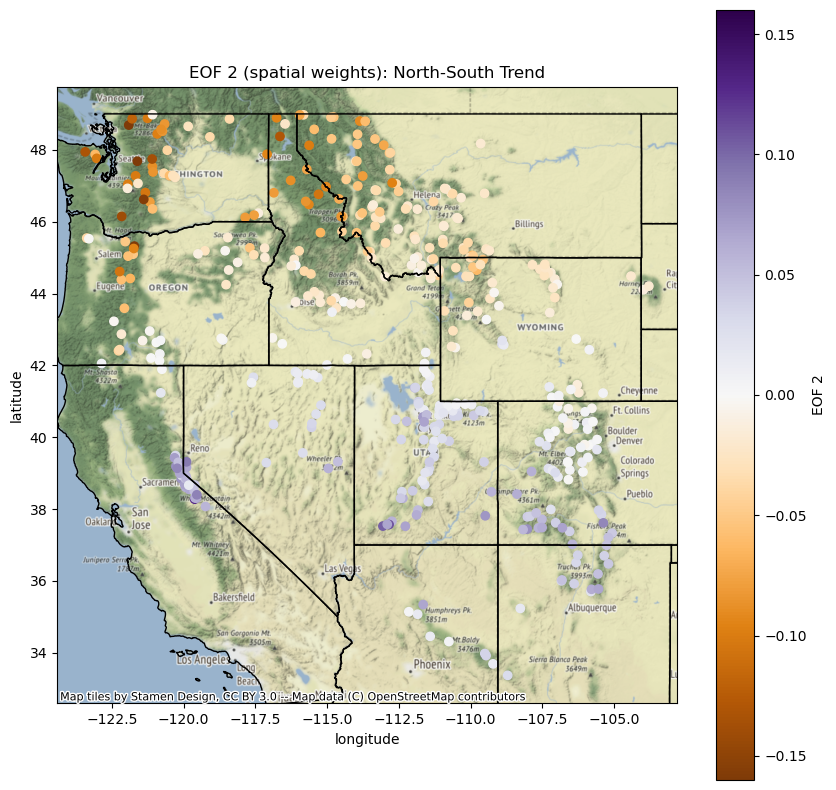

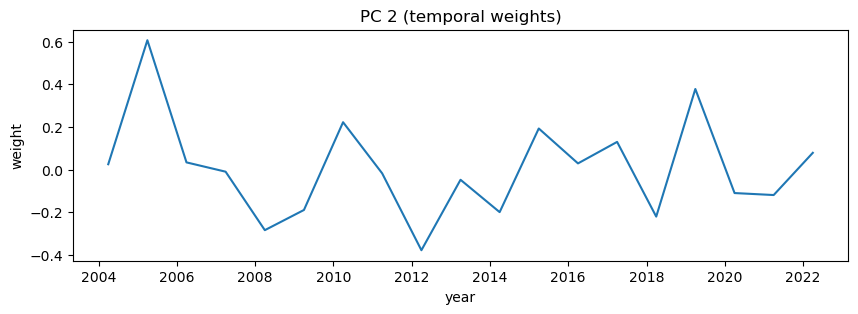

In [43]:
# Only using snotel
i = 1
#western_snotel_nan['U2'] = U[:,i]
# plot first EOF (U)
fig, ax = plt.subplots(figsize=(10,10))
western_snotel_nan.plot(ax=ax, column=-1*U[:,i], legend=True, cmap='PuOr', legend_kwds={'label': "EOF 2",'orientation': "vertical"}, vmin=-0.16, vmax=0.16)
ctx.add_basemap(ax=ax, crs='epsg:4326', source=ctx.providers.Stamen.Terrain)
western_states.plot(ax=ax, facecolor='none', edgecolor='k')
plt.title('EOF 2 (spatial weights): North-South Trend');
plt.xlabel('longitude')
plt.ylabel('latitude')

plt.figure(figsize=(10,3))
plt.plot(dates,V[i,:]);
plt.title('PC 2 (temporal weights)');
plt.xlabel('year')
plt.ylabel('weight')

Text(0, 0.5, 'weight')

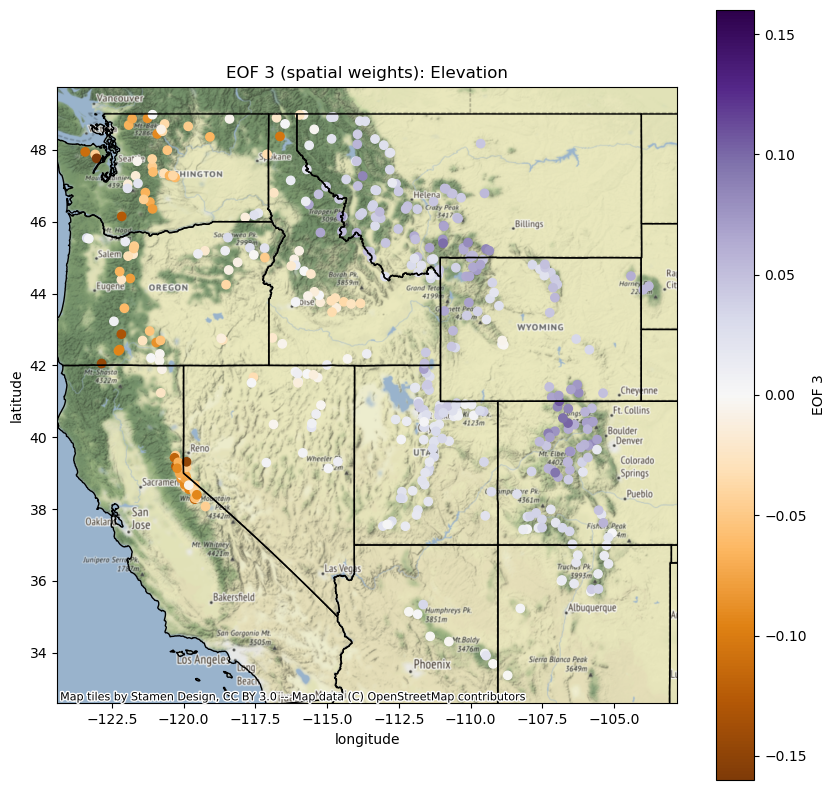

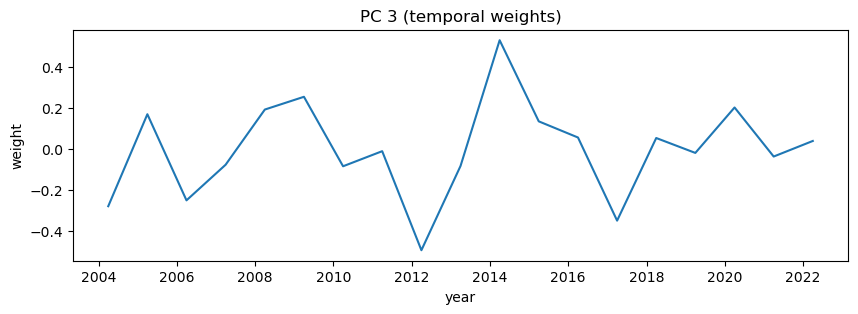

In [44]:
i = 2
#western_snotel_nan['U3'] = U[:,i]
# plot first EOF (U)
fig, ax = plt.subplots(figsize=(10,10))
western_snotel_nan.plot(ax=ax, column=-1*U[:,i], legend=True, cmap='PuOr', legend_kwds={'label': "EOF 3",'orientation': "vertical"}, vmin=-0.16, vmax=0.16)
ctx.add_basemap(ax=ax, crs='epsg:4326', source=ctx.providers.Stamen.Terrain)
western_states.plot(ax=ax, facecolor='none', edgecolor='k')
plt.title('EOF 3 (spatial weights): Elevation');
plt.xlabel('longitude')
plt.ylabel('latitude')

plt.figure(figsize=(10,3))
plt.plot(dates,V[i,:]);
plt.title('PC 3 (temporal weights)');
plt.xlabel('year')
plt.ylabel('weight')

Text(0, 0.5, 'weight')

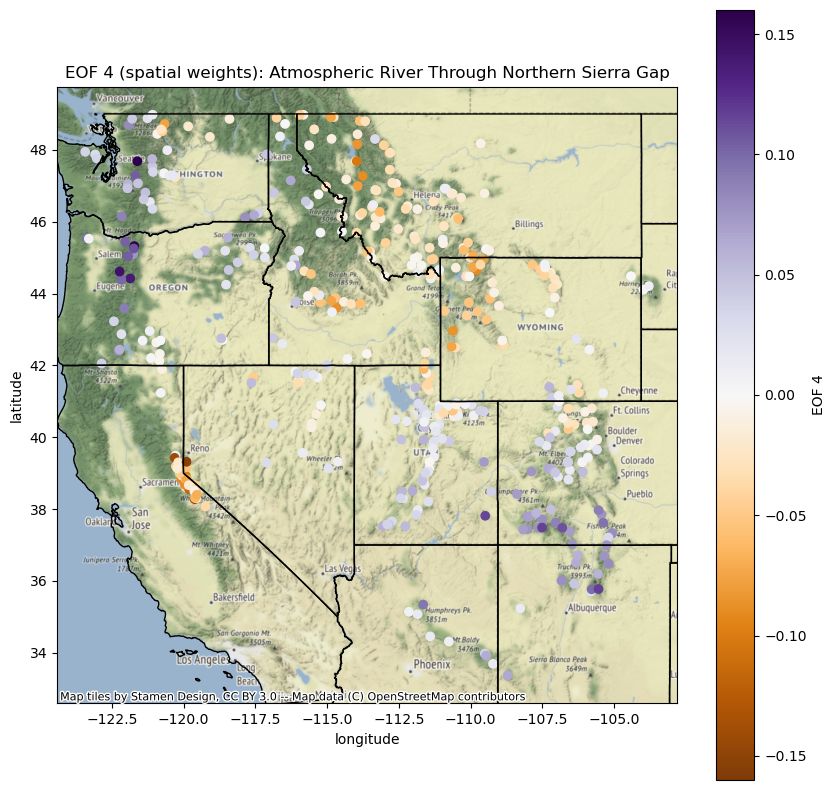

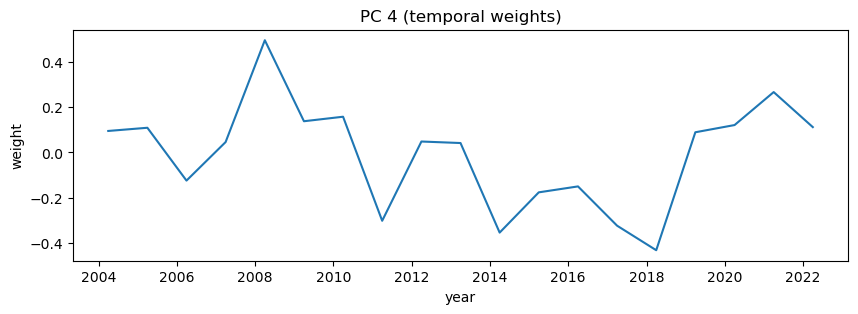

In [45]:
i = 3

# plot first EOF (U)
fig, ax = plt.subplots(figsize=(10,10))
western_snotel_nan.plot(ax=ax, column=-1*U[:,i], legend=True, cmap='PuOr', legend_kwds={'label': "EOF 4",'orientation': "vertical"}, vmin=-0.16, vmax=0.16)
ctx.add_basemap(ax=ax, crs='epsg:4326', source=ctx.providers.Stamen.Terrain)
western_states.plot(ax=ax, facecolor='none', edgecolor='k')
plt.title('EOF 4 (spatial weights): Atmospheric River Through Northern Sierra Gap');
plt.xlabel('longitude')
plt.ylabel('latitude')

plt.figure(figsize=(10,3))
plt.plot(dates,V[i,:]);
plt.title('PC 4 (temporal weights)');
plt.xlabel('year')
plt.ylabel('weight')

In [232]:
# SVD Variance Explained, divide S values by the sum of all S
var_exp = S / np.sum(S)

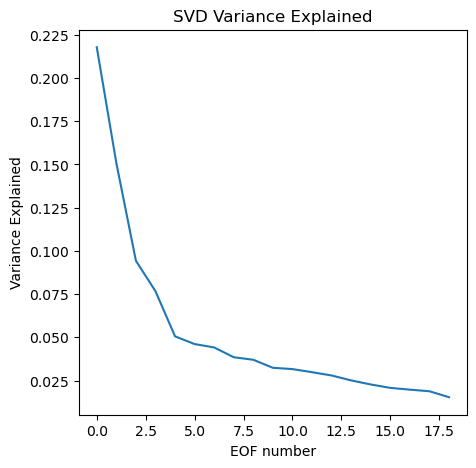

In [31]:
plt.figure(figsize=(5,5))
plt.plot(var_exp)
plt.xlabel('EOF number')
plt.ylabel('Variance Explained')
plt.title('SVD Variance Explained');

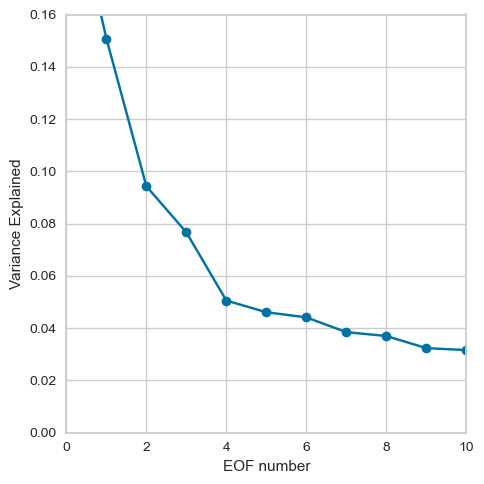

In [233]:
plt.figure(figsize=(5,5))
plt.plot(var_exp,'-o')
plt.xlabel('EOF number')
plt.ylabel('Variance Explained')
#plt.title('SVD Variance Explained')
plt.ylim([0,0.16])
plt.xlim([0,10])
plt.tight_layout()
plt.savefig('../../../QualifyingExam/eof_varianceexplained.jpeg');

In [33]:
# the first 10:
print(var_exp[0:10])

# sum of the first 10
print('Percent of overall variance expplained by the top 10 patterns = {}%'.format( np.round( 100*np.sum(var_exp[0:10]),1)))

[0.2177704  0.15081693 0.09428717 0.07665291 0.05056428 0.04609489
 0.04413395 0.03847871 0.03701054 0.03237113]
Percent of overall variance expplained by the top 10 patterns = 78.8%


In [208]:
# the first 10:
print(var_exp[0:4])

# sum of the first 10
print('Percent of overall variance expplained by the top 4 patterns = {}%'.format( np.round( 100*np.sum(var_exp[0:4]),1)))

[0.2177704  0.15081693 0.09428717 0.07665291]
Percent of overall variance expplained by the top 4 patterns = 54.0%


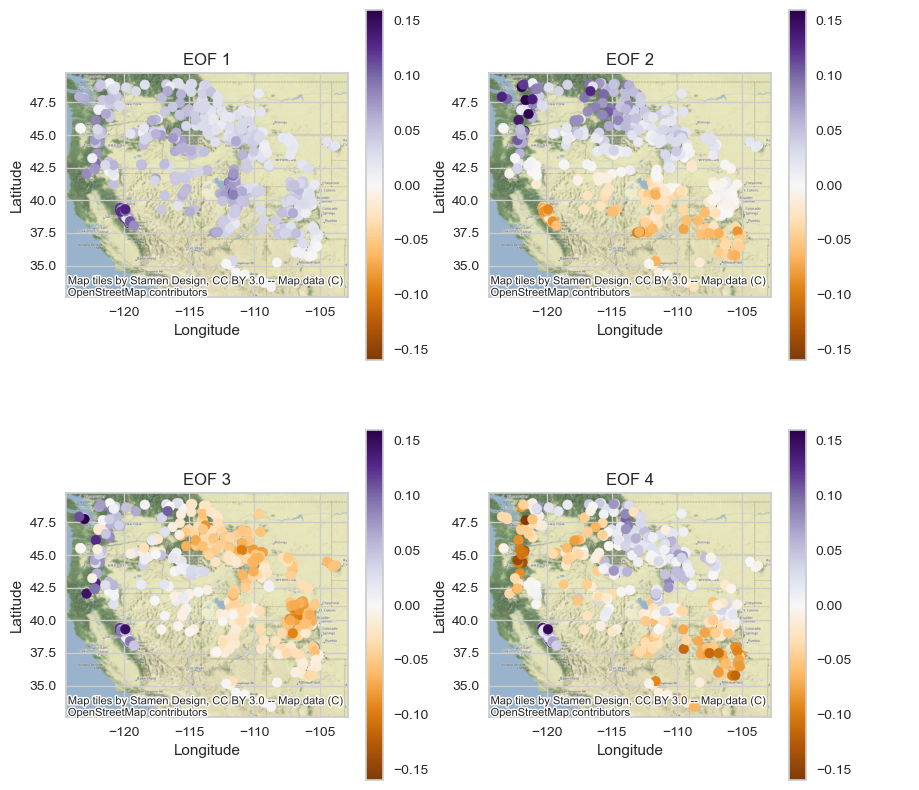

In [234]:
f, ax = plt.subplots(2,2,figsize=(10,10))
i = 0
for row in range(2):
    for column in range(2):     
        western_snotel_nan.plot(ax=ax[row,column], column=-1*U[:,i], legend=True, cmap='PuOr', vmin=-0.16, vmax=0.16)
        ctx.add_basemap(ax=ax[row,column], crs='epsg:4326', source=ctx.providers.Stamen.Terrain)
        ax[row,column].set_title('EOF {}'.format(i+1))
        ax[row,column].set_xlabel('Longitude')
        ax[row,column].set_ylabel('Latitude')
        i+=1

#plt.tight_layout()
plt.savefig('../../../QualifyingExam/eof_top4.jpeg')

EOF3 is elevation - could plot EOF vs temperature. The EOFs are additive - so EOF4 is extra moisture delivered to certain regions from atmospheric rivers coming through the gap in the northern Sierras. These are often warm storms so higher elevations also get snow while lower elevations get rain. All of these show discontinuities in the Rockies. could draw a line in colorado that is separated by maybe a certain mountain range. I should plot just CO to zoom in. Oregon and washington can probably get lumped, california is its own thing that clumps together nicely. Idaho might need a split down the middle (east-west). Could try to use another clustering method in addition to this EOF. then zoom into mountain ranges - does it make sensethat colors align with certain ridges or mountain ranges. ID these regions, then try to predict swe at another site from swe at one site. wha'ts the predictive power? r2? use sites with good records only. do a correlation analysis from a central site. how well can i predict sites within the boundary i drew vs sites outside the boundary i drew? does the r2 suddenly drop? Run through a few sites by myself, then brute force it for all sites (look for computer methods to do this). Could also repeat the eof in a certain area for the swe reanalysis. the snotel sites give me the larger picture, and then i can use swe reanalysis to zoom in. IF I zoom in and rerun, this will give me more granularity for each range to determine the boundaries where things change. Is it exactly on a certain ridge? etc. 

In [38]:
colorado = western_states[western_states['NAME'] == 'Colorado']

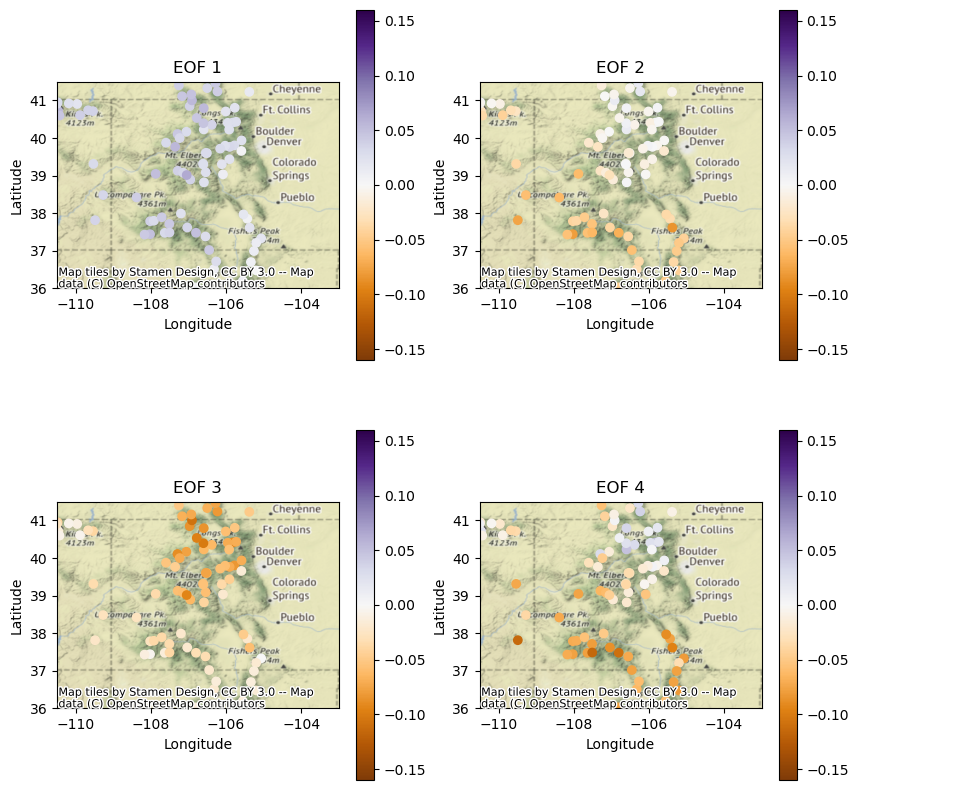

In [47]:
f, ax = plt.subplots(2,2,figsize=(10,10))
i = 0
for row in range(2):
    for column in range(2):     
        western_snotel_nan.plot(ax=ax[row,column], column=-1*U[:,i], legend=True, cmap='PuOr', vmin=-0.16, vmax=0.16)
        ctx.add_basemap(ax=ax[row,column], crs='epsg:4326', source=ctx.providers.Stamen.Terrain)
        ax[row,column].set_xlim(-110.5,-103)
        ax[row,column].set_ylim(36,41.5)
        ax[row,column].set_title('EOF {}'.format(i+1))
        ax[row,column].set_xlabel('Longitude')
        ax[row,column].set_ylabel('Latitude')
        i+=1

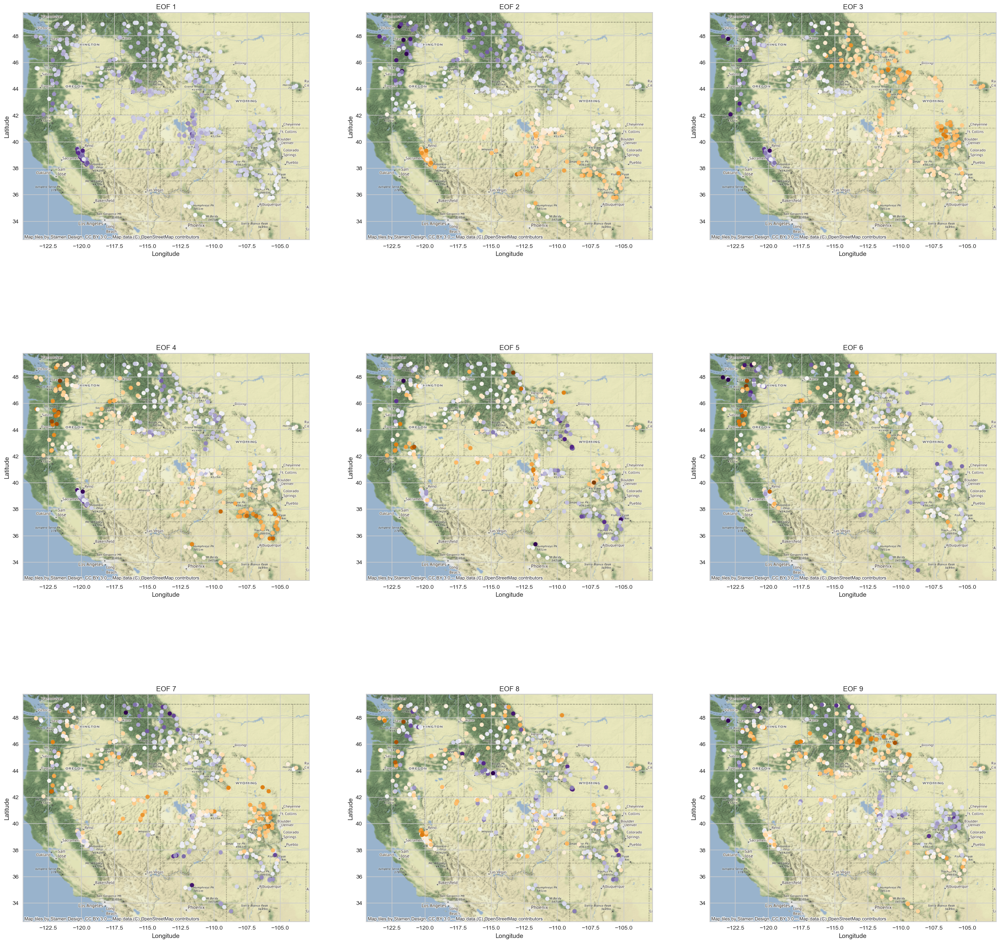

In [201]:
f, ax = plt.subplots(3,3
                     ,figsize=(30,30))
i = 0
for row in range(3):
    for column in range(3): 
        im1 = western_snotel_nan.plot(ax=ax[row,column], column=-1*U[:,i], cmap='PuOr', legend=False, vmin=-0.16, vmax=0.16)
        ctx.add_basemap(ax=ax[row,column], crs='epsg:4326', source=ctx.providers.Stamen.Terrain)
        ax[row,column].set_title('EOF {}'.format(i+1))
        ax[row,column].set_xlabel('Longitude')
        ax[row,column].set_ylabel('Latitude')
        i+=1
plt.savefig('../figures/eof_1_10_nolegend.jpeg')
# ax_divider = make_axes_locatable(ax[1,4])
# # Add an Axes to the right of the main Axes.
# cax1 = ax_divider.append_axes("right", size="7%", pad="2%")
# cb1 = plt.colorbar(im1, cax=cax1)

NOAA has summaries of water years, I could go back and read the reports from the years that are highlighted in the PCs. Jessica will send me lit on storm tracks showing how moisture from Ca makes its way into the interior. If I use a variogram, use data on a regular grid like snowmodel and swe reanalysis data. Jeff Deems - phd work on early lidar variograms. ITs most useful on things with patterns as opposed to boundary drawing. i dont just want length scales. i might want more of a brute force method - drop the spatial lag (from variograms) and just compute the correlations between all sites (this is probably a formal method but jessica doesnt remember - ask Jon?)

In [ ]:
f, ax = plt.subplots(2,5,figsize=(30,10))
i = 0
for row in range(2):
    for column in range(5): 
        im1 = western_snotel_nan.plot(ax=ax[row,column], column=U[:,i], legend=True, cmap='PuOr', vmin=-0.16, vmax=0.16)
        ctx.add_basemap(ax=ax[row,column], crs='epsg:4326', source=ctx.providers.Stamen.Terrain)
        ax[row,column].set_title('EOF {}'.format(i+1))
        ax[row,column].set_xlabel('Longitude')
        ax[row,column].set_ylabel('Latitude')
        i+=1

ax_divider = make_axes_locatable(ax[1,4])
# Add an Axes to the right of the main Axes.
cax1 = ax_divider.append_axes("right", size="7%", pad="2%")
cb1 = fig.colorbar(im1, cax=cax1)

In [ ]:
f, ax = plt.subplots(2,5,figsize=(30,10))
i = 0
for row in range(2):
    for column in range(5):     
        western_snotel_nan.plot(ax=ax[row,column], column=U[:,i], legend=True, cmap='PuOr', vmin=-0.16, vmax=0.16)
        ctx.add_basemap(ax=ax[row,column], crs='epsg:4326', source=ctx.providers.Stamen.Terrain)
        ax[row,column].set_title('EOF {}'.format(i+1))
        ax[row,column].set_xlabel('Longitude')
        ax[row,column].set_ylabel('Latitude')
        i+=1

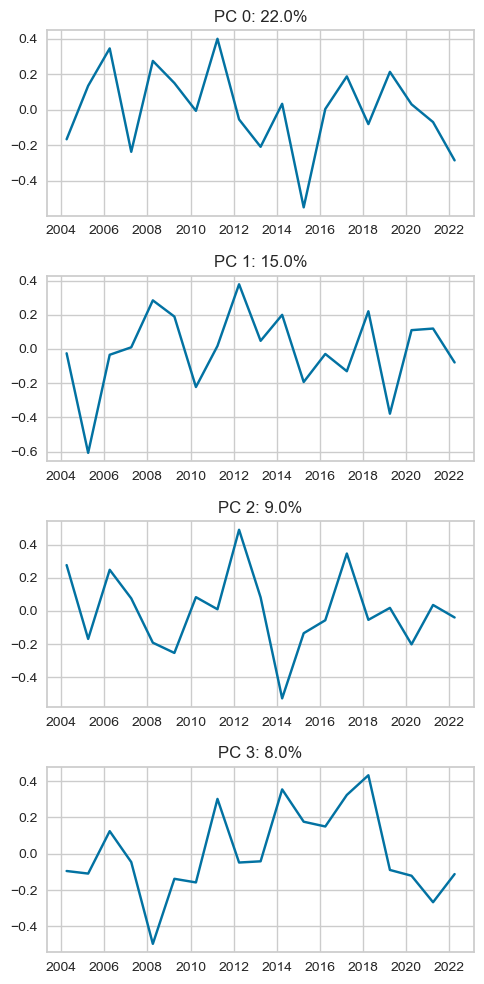

In [235]:
# Plot the 10 leading PCs
f, ax = plt.subplots(4,1,figsize=(5,10))
for i in range(4):
    ax[i].plot(dates,-1*V[i,:]); # with -1 multiplier
    ax[i].set_title('PC {}: {}%'.format(i,np.round(100*var_exp[i]),2));
plt.tight_layout()
plt.savefig('../../../QualifyingExam/pc_top4.jpeg')

## K-means Clustering

In [45]:
from sklearn.cluster import KMeans

In [127]:
pearsons_cc = np.corrcoef(combined_april1_array.T)

In [133]:
!pwd

/Users/Hannah/Documents/Documents_Grad/Research/CorrelatedDomains/notebooks


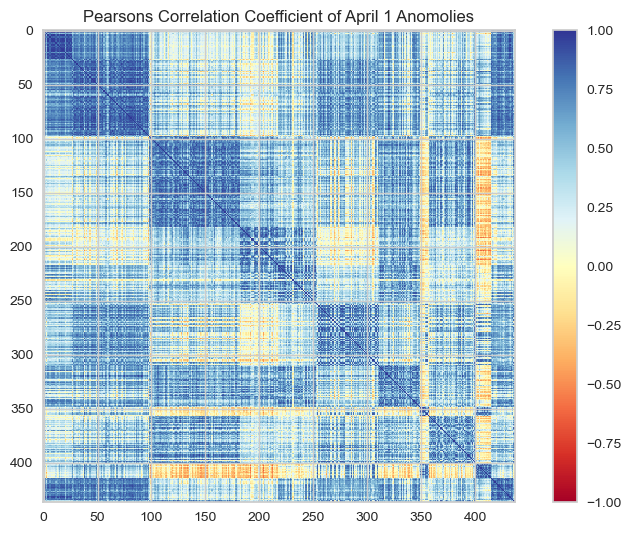

In [205]:
# code from https://www.kaggle.com/code/ignacioalorre/clustering-features-based-on-correlation-and-tags

plt.figure()
plt.imshow(pearsons_cc, interpolation='nearest', cmap ='RdYlBu', vmin=-1, vmax=1)
plt.colorbar()
plt.title('Pearsons Correlation Coefficient of April 1 Anomolies')
plt.tight_layout()
plt.savefig('../../../QualifyingExam/Pearsons_Corr_heatmap.jpeg')

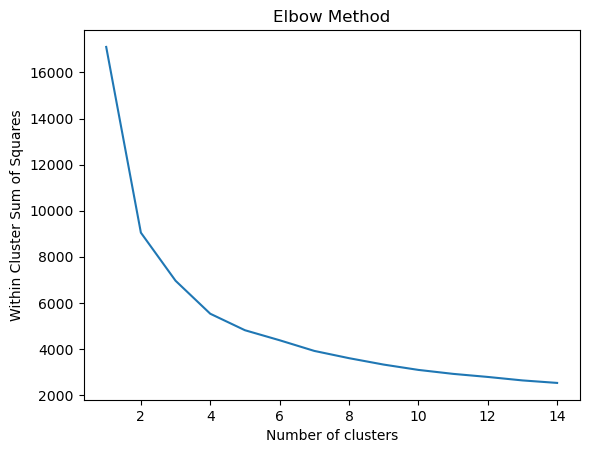

In [128]:
# code from https://www.kaggle.com/code/ignacioalorre/clustering-features-based-on-correlation-and-tags
# Determine optimun number of clusters for kmeans
wcss = []
max_num_clusters = 15
for i in range(1, max_num_clusters):
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=0)
    kmeans.fit(pearsons_cc)
    wcss.append(kmeans.inertia_)
fig, ax = plt.subplots()    
plt.plot(range(1, max_num_clusters), wcss)
plt.title('Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('Within Cluster Sum of Squares')
plt.show()
#plt.savefig('../../../QualifyingExam/elbow_method.jpeg')

## Interpretation:  
The elbow method doesn't seem very useful here - there's no elbow! 

In [82]:
import sklearn

/Users/Hannah/micromamba/envs/analysis_2023/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Users/Hannah/micromamba/envs/analysis_2023/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Users/Hannah/micromamba/envs/analysis_2023/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Users/Hannah/micromamba/envs/analysis_2023/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `

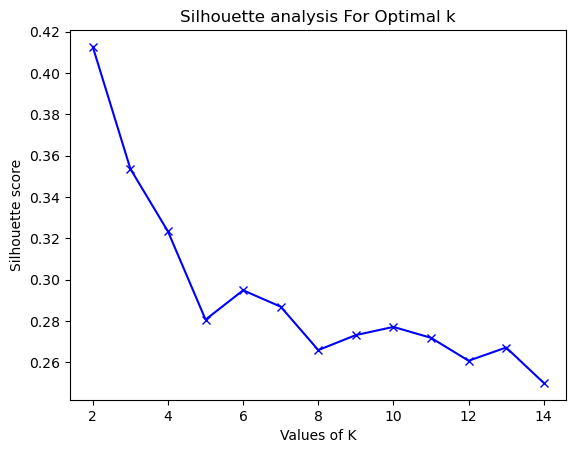

<Figure size 640x480 with 0 Axes>

In [130]:
# code from https://www.analyticsvidhya.com/blog/2021/05/k-mean-getting-the-optimal-number-of-clusters/
#import sklearn.metrics.silhouette_score as silhouette_score
range_n_clusters = [2, 3, 4, 5, 6, 7, 8,9,10,11,12,13,14]
silhouette_avg = []
for num_clusters in range_n_clusters:
    # initialise kmeans
    kmeans = KMeans(n_clusters=num_clusters, n_init=10)
    kmeans.fit(pearsons_cc)
    cluster_labels = kmeans.labels_
    # silhouette score
    silhouette_avg.append(sklearn.metrics.silhouette_score(pearsons_cc, cluster_labels))
plt.plot(range_n_clusters,silhouette_avg,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Silhouette score') 
plt.title('Silhouette analysis For Optimal k')
plt.show()
plt.tight_layout()
#plt.savefig('../../../QualifyingExam/avg_silhouette.jpeg')

In [131]:
from yellowbrick.cluster import SilhouetteVisualizer
  
fig, ax = plt.subplots(3, 3, figsize=(15,15))
for i in [2, 3, 4, 5, 6, 7, 8, 9, 10]:
    '''
    Create KMeans instances for different number of clusters
    '''
    km = KMeans(n_clusters=i, init='k-means++', n_init=10, max_iter=100, random_state=42)
    q, mod = divmod(i, 3)
    '''
    Create SilhouetteVisualizer instance with KMeans instance
    Fit the visualizer
    '''
    visualizer = SilhouetteVisualizer(km, colors='yellowbrick', ax=ax[q-1][mod])
    visualizer.fit(pearsons_cc) 
    ax[q-1][mod].set_title('{} Clusters'.format(i))

#plt.savefig('../../../QualifyingExam/silhouettevisualization.jpeg')

ModuleNotFoundError: No module named 'yellowbrick'

In [68]:
len(feat_names)

437

In [69]:
snwd_april1_anom_nan.shape

(19, 437)

In [70]:
pearsons_cc_labels

array([7, 4, 1, 2, 3, 3, 4, 1, 3, 2, 0, 6, 5, 1, 0, 4, 0, 2, 6],
      dtype=int32)

In [134]:
# Continued code from https://www.kaggle.com/code/ignacioalorre/clustering-features-based-on-correlation-and-tags

# Using kmeans to cluster the features based on their correlation
n_clusters_kmeans = 6
kmeans = KMeans(n_clusters = n_clusters_kmeans, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0)
pearsons_cc_labels = kmeans.fit_predict(pearsons_cc)
feat_names = combined_april1_anom.columns
# Preparing a dataframe to collect some cluster stats
pearsons_cc_clust_df = pd.DataFrame(np.c_[feat_names, pearsons_cc_labels])
pearsons_cc_clust_df.columns = ["feature", "cluster"]
pearsons_cc_clust_df['feat_list'] = pearsons_cc_clust_df.groupby(["cluster"]).transform(lambda x: ', '.join(x))
pearsons_cc_clust_df = pearsons_cc_clust_df.groupby(["cluster", "feat_list"]).size().reset_index(name = 'feat_count')
pearsons_cc_clust_df

,cluster,feat_list,feat_count
0,0,"301_CA_SNTL, 356_CA_SNTL, 1051_CA_SNTL, 1067_C...",157
1,1,"916_MT_SNTL, 313_MT_SNTL, 315_MT_SNTL, 328_MT_...",91
2,2,"383_UT_SNTL, 452_UT_SNTL, 865_UT_SNTL, 303_CO_...",36
3,3,"374_UT_SNTL, 455_UT_SNTL, 517_UT_SNTL, 521_UT_...",82
4,4,"307_MT_SNTL, 311_MT_SNTL, 414_MT_SNTL, 469_MT_...",81
5,5,"522_UT_SNTL, 528_UT_SNTL, 753_MT_SNTL, 743_OR_...",47


In [135]:
# Continued code from https://www.kaggle.com/code/ignacioalorre/clustering-features-based-on-correlation-and-tags

corr_node_dist = kmeans.transform(pearsons_cc)
corr_clust_dist = np.c_[feat_names, np.round(corr_node_dist.min(axis=1),3), np.round(corr_node_dist.min(axis=1)/np.max(corr_node_dist.min(axis=1)),3), pearsons_cc_labels]
corr_clust_dist_df = pd.DataFrame(corr_clust_dist)
corr_clust_dist_df.columns = ['feature', 'dist_corr', 'dist_corr_norm', 'cluster_corr']
corr_clust_dist_df

,feature,dist_corr,dist_corr_norm,cluster_corr
0,301_CA_SNTL,2.331,0.327,0
1,356_CA_SNTL,1.787,0.251,0
2,1051_CA_SNTL,2.417,0.339,0
3,1067_CA_SNTL,2.11,0.296,0
4,977_CA_SNTL,3.915,0.549,0
...,...,...,...,...
489,RCK,2.986,0.418,5
490,CXS,2.138,0.3,0
491,BLK,1.756,0.246,0
492,IDC,4.334,0.607,0


In [136]:
corr_clust_dist_df.T.head()

,0,1,2,3,4,5,6,7,8,9,...,484,485,486,487,488,489,490,491,492,493
feature,301_CA_SNTL,356_CA_SNTL,1051_CA_SNTL,1067_CA_SNTL,977_CA_SNTL,462_CA_SNTL,463_CA_SNTL,473_CA_SNTL,1049_CA_SNTL,508_CA_SNTL,...,HOR,INN,TUM,TK2,MRL,RCK,CXS,BLK,IDC,SDW
dist_corr,2.331,1.787,2.417,2.11,3.915,2.439,2.197,2.045,2.221,2.267,...,2.166,2.379,1.871,2.349,1.84,2.986,2.138,1.756,4.334,1.967
dist_corr_norm,0.327,0.251,0.339,0.296,0.549,0.342,0.308,0.287,0.311,0.318,...,0.304,0.333,0.262,0.329,0.258,0.418,0.3,0.246,0.607,0.276
cluster_corr,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,5,0,0,0,0


In [114]:
western_snotel_nan.head(2)

,code,name,network,elevation_m,site_property,GEO_ID,STATE,NAME,LSAD,CENSUSAREA,geometry,cluster_corr
code,,,,,,,,,,,,
301_CA_SNTL,301_CA_SNTL,Adin Mtn,SNOTEL,1886.712036,"{'county': 'Modoc', 'state': 'California', 'si...",0400000US06,06,California,,155779.22,POINT (-120.79192 41.23583),2
356_CA_SNTL,356_CA_SNTL,Blue Lakes,SNOTEL,2458.821533,"{'county': 'Alpine', 'state': 'California', 's...",0400000US06,06,California,,155779.22,POINT (-119.92437 38.60800),2


In [137]:
cluster_array = corr_clust_dist_df['cluster_corr'].values
cluster_array

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 2, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 2, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3,
       5, 5, 3, 0, 0, 0, 0, 0, 3, 0, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 3, 0, 0, 3, 0, 0, 0, 0, 0, 2,
       1, 4, 4, 1, 1, 3, 1, 1, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4,
       1, 1, 1, 1, 1, 1, 4, 1, 4, 1, 4, 4, 4, 4, 4, 3, 3, 1, 4, 1, 1, 1,
       3, 4, 1, 4, 4, 1, 1, 4, 1, 4, 4, 1, 1, 1, 1, 4, 1, 4, 1, 1, 1, 1,
       1, 5, 1, 4, 1, 1, 4, 1, 4, 3, 1, 1, 4, 4, 4, 3, 3, 1, 1, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 1, 4, 4, 4, 4, 4, 4, 4, 3, 4, 4, 3, 3, 3, 3, 3, 3, 3, 3, 4,
       3, 3, 4, 3, 3, 1, 3, 3, 0, 3, 1, 3, 3, 4, 4, 3, 3, 1, 4, 1, 4, 4,
       0, 3, 3, 3, 5, 3, 3, 3, 4, 0, 3, 3, 3, 3, 5, 2, 5, 5, 0, 5, 5, 0,
       5, 5, 1, 0, 0, 2, 5, 0, 0, 5, 2, 0, 5, 5, 2,

In [140]:
#western_snotel_nan['cluster_corr'] = cluster_array
station_locations['cluster_corr'] = cluster_array

In [141]:
corr_clust_dist_df['cluster_corr'].shape

(494,)

In [142]:
#western_snotel_nan.shape
station_locations.shape

(494, 6)

In [229]:
western_snotel_nan.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

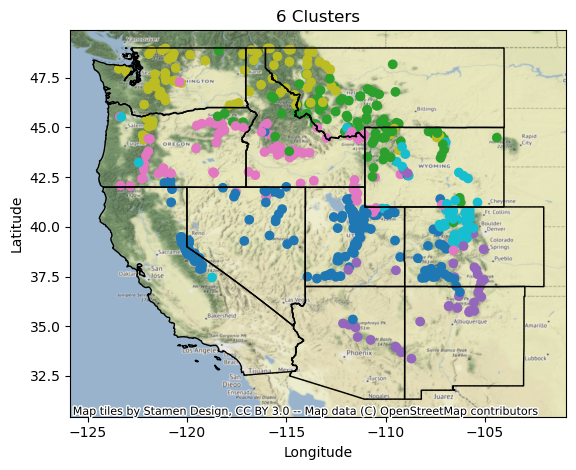

In [143]:
fig, ax = plt.subplots()

station_locations.plot(ax=ax, column='cluster_corr')
wstates.to_crs('epsg:4326').plot(ax=ax, facecolor='none')
ctx.add_basemap(ax=ax, crs='epsg:4326', source=ctx.providers.Stamen.Terrain)
ax.set_title('6 Clusters')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

plt.tight_layout()
#plt.savefig('../../../QualifyingExam/map_6clusters.jpeg')
#ax_divider = make_axes_locatable(ax[1,4])
# Add an Axes to the right of the main Axes.
#cax1 = ax_divider.append_axes("right", size="7%", pad="2%")
#cb1 = fig.colorbar(im1, cax=cax1)

/Users/Hannah/opt/miniconda3/envs/analysis_2022/lib/python3.8/site-packages/geopandas/plotting.py:802: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  cat = pd.Categorical(values, categories=categories)


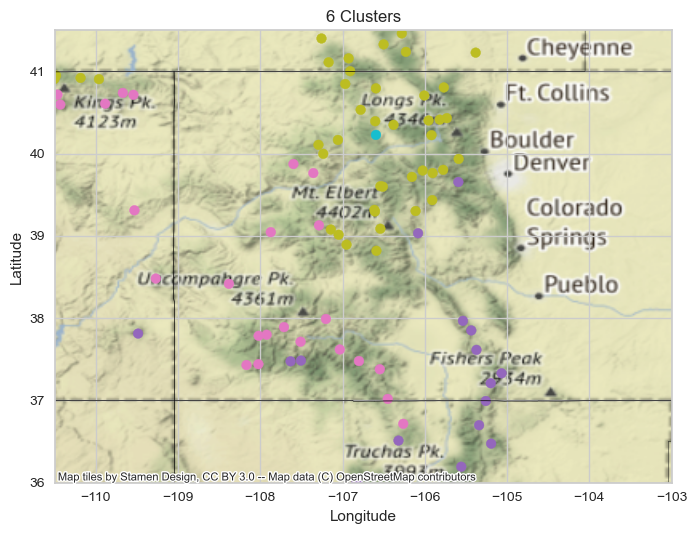

In [236]:
fig, ax = plt.subplots()

western_snotel_nan.plot(ax=ax, column='cluster_corr')
wstates.to_crs('epsg:4326').plot(ax=ax, facecolor='none')
ctx.add_basemap(ax=ax, crs='epsg:4326', source=ctx.providers.Stamen.Terrain)
ax.set_title('6 Clusters')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_xlim(-110.5,-103)
ax.set_ylim(36,41.5)
plt.tight_layout()
plt.savefig('../../../QualifyingExam/map_6clusters_CO.jpeg')
#ax_divider = make_axes_locatable(ax[1,4])
# Add an Axes to the right of the main Axes.
#cax1 = ax_divider.append_axes("right", size="7%", pad="2%")
#cb1 = fig.colorbar(im1, cax=cax1)

In [160]:
# Using kmeans to cluster the features based on their correlation
def cluster(n_clusters_kmeans, correlation_df):

    kmeans = KMeans(n_clusters = n_clusters_kmeans, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0)
    pearsons_cc_labels = kmeans.fit_predict(correlation_df)
    feat_names = snwd_april1_anom_nan.columns
    # Preparing a dataframe to collect some cluster stats
    pearsons_cc_clust_df = pd.DataFrame(np.c_[feat_names, pearsons_cc_labels])
    pearsons_cc_clust_df.columns = ["feature", "cluster"]
    pearsons_cc_clust_df['feat_list'] = pearsons_cc_clust_df.groupby(["cluster"]).transform(lambda x: ', '.join(x))
    pearsons_cc_clust_df = pearsons_cc_clust_df.groupby(["cluster", "feat_list"]).size().reset_index(name = 'feat_count')

    corr_node_dist = kmeans.transform(correlation_df)
    corr_clust_dist = np.c_[feat_names, np.round(corr_node_dist.min(axis=1),3), np.round(corr_node_dist.min(axis=1)/np.max(corr_node_dist.min(axis=1)),3), pearsons_cc_labels]
    corr_clust_dist_df = pd.DataFrame(corr_clust_dist)
    corr_clust_dist_df.columns = ['feature', 'dist_corr', 'dist_corr_norm', 'cluster_corr']

    cluster_array = corr_clust_dist_df['cluster_corr'].values
    western_snotel_nan['cluster_corr'] = cluster_array
    
    fig, ax = plt.subplots()

    western_snotel_nan.plot(ax=ax, column='cluster_corr')
    ctx.add_basemap(ax=ax, crs='epsg:4326', source=ctx.providers.Stamen.Terrain)
    ax.set_title('{} Clusters'.format(n_clusters_kmeans))
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    plt.savefig('../../../QualifyingExam/spatial_dist_{}clusters.jpeg'.format(n_clusters_kmeans))

/Users/Hannah/opt/miniconda3/envs/analysis_2022/lib/python3.8/site-packages/geopandas/plotting.py:802: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  cat = pd.Categorical(values, categories=categories)


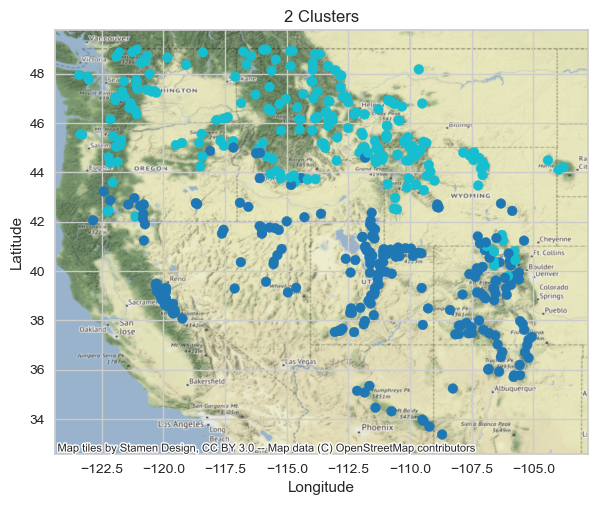

In [161]:
cluster(2, pearsons_cc)

/Users/Hannah/opt/miniconda3/envs/analysis_2022/lib/python3.8/site-packages/geopandas/plotting.py:802: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  cat = pd.Categorical(values, categories=categories)


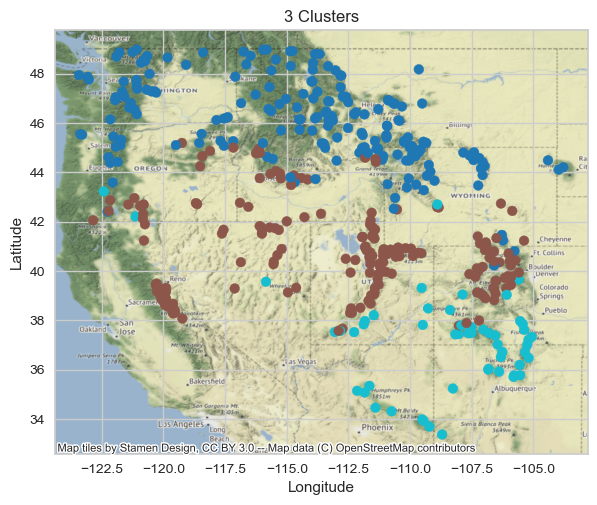

In [162]:
cluster(3, pearsons_cc)

/Users/Hannah/opt/miniconda3/envs/analysis_2022/lib/python3.8/site-packages/geopandas/plotting.py:802: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  cat = pd.Categorical(values, categories=categories)


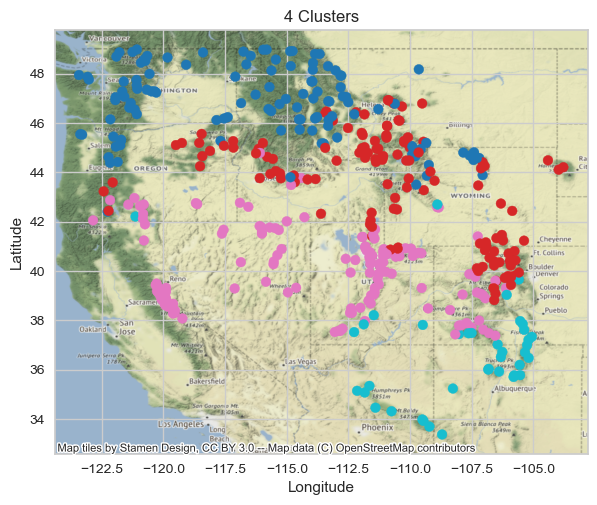

In [163]:
cluster(4, pearsons_cc)

/Users/Hannah/opt/miniconda3/envs/analysis_2022/lib/python3.8/site-packages/geopandas/plotting.py:802: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  cat = pd.Categorical(values, categories=categories)


Text(112.82217830712675, 0.5, 'Latitude')

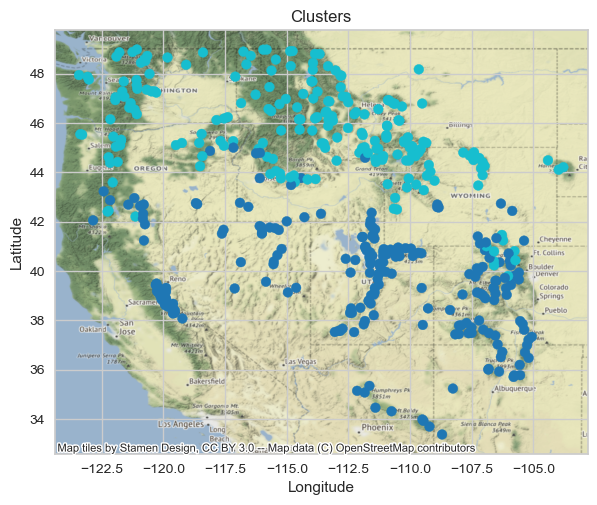

In [154]:
fig, ax = plt.subplots()

western_snotel_nan.plot(ax=ax, column='cluster_corr')
ctx.add_basemap(ax=ax, crs='epsg:4326', source=ctx.providers.Stamen.Terrain)
ax.set_title('Clusters')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

/Users/Hannah/opt/miniconda3/envs/analysis_2022/lib/python3.8/site-packages/geopandas/plotting.py:802: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  cat = pd.Categorical(values, categories=categories)
/Users/Hannah/opt/miniconda3/envs/analysis_2022/lib/python3.8/site-packages/geopandas/plotting.py:802: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  cat = pd.Categorical(values, categories=categories)
/Users/Hannah/opt/miniconda3/envs/analysis_2022/lib/python3.8/site-packages/geopandas/plotting.py:802: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  cat = pd.Categorical(values, categories=categories)
/Users/Hannah/opt/miniconda3/envs/analysis_2022/lib/python3.8/site-packages/geo

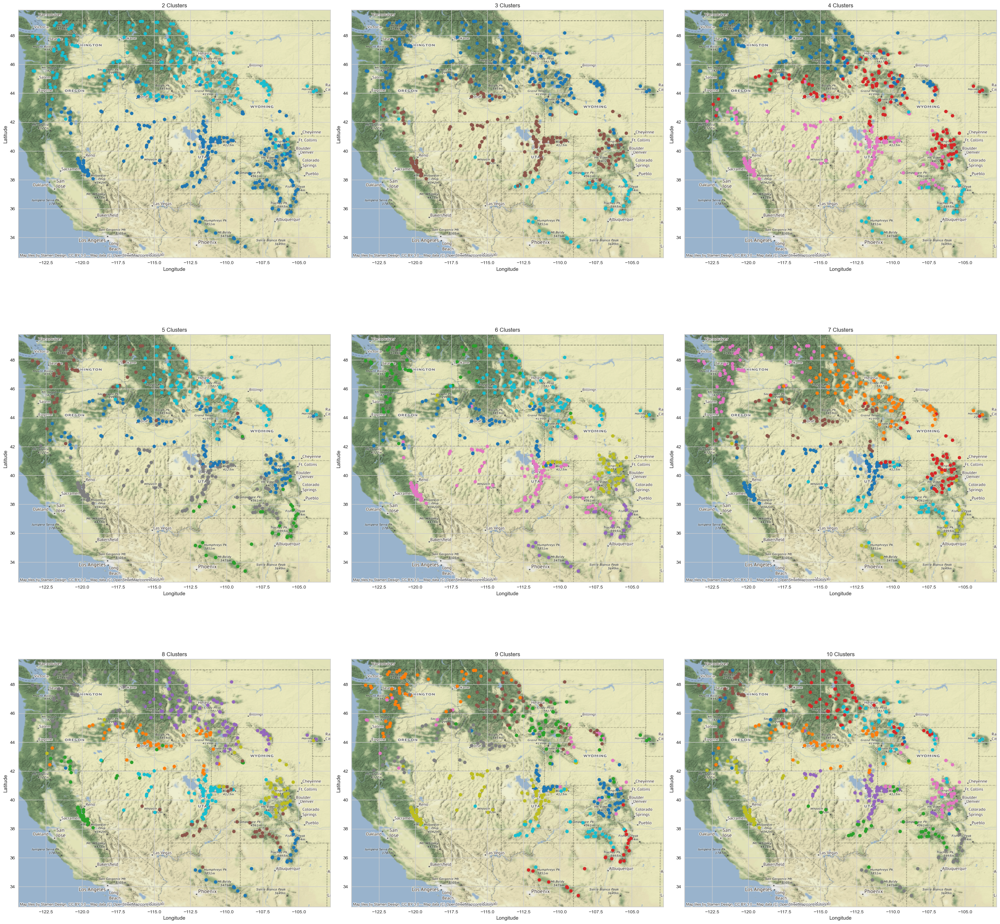

In [203]:
f, ax = plt.subplots(3,3,figsize=(30,30))
i = 0
for row in range(3):
    for column in range(3): 
        kmeans = KMeans(n_clusters = i+2, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0)
        pearsons_cc_labels = kmeans.fit_predict(pearsons_cc)
        feat_names = snwd_april1_anom_nan.columns
        # Preparing a dataframe to collect some cluster stats
        pearsons_cc_clust_df = pd.DataFrame(np.c_[feat_names, pearsons_cc_labels])
        pearsons_cc_clust_df.columns = ["feature", "cluster"]
        pearsons_cc_clust_df['feat_list'] = pearsons_cc_clust_df.groupby(["cluster"]).transform(lambda x: ', '.join(x))
        pearsons_cc_clust_df = pearsons_cc_clust_df.groupby(["cluster", "feat_list"]).size().reset_index(name = 'feat_count')

        corr_node_dist = kmeans.transform(pearsons_cc)
        corr_clust_dist = np.c_[feat_names, np.round(corr_node_dist.min(axis=1),3), np.round(corr_node_dist.min(axis=1)/np.max(corr_node_dist.min(axis=1)),3), pearsons_cc_labels]
        corr_clust_dist_df = pd.DataFrame(corr_clust_dist)
        corr_clust_dist_df.columns = ['feature', 'dist_corr', 'dist_corr_norm', 'cluster_corr']

        cluster_array = corr_clust_dist_df['cluster_corr'].values
        western_snotel_nan['cluster_corr'] = cluster_array
        
        western_snotel_nan.plot(ax=ax[row,column], column='cluster_corr')
        ctx.add_basemap(ax=ax[row,column], crs='epsg:4326', source=ctx.providers.Stamen.Terrain)
        ax[row,column].set_title('{} Clusters'.format(i+2))
        ax[row,column].set_xlabel('Longitude')
        ax[row,column].set_ylabel('Latitude')
        
        i+=1
plt.tight_layout()
plt.savefig('../../../QualifyingExam/spatial_dist_clusters2_10.jpeg')
# ax_divider = make_axes_locatable(ax[1,3])
# # Add an Axes to the right of the main Axes.
# cax1 = ax_divider.append_axes("right", size="7%", pad="2%")
# cb1 = fig.colorbar(im1, cax=cax1)

In [183]:
# Using kmeans to cluster the features based on their correlation
def cluster_plots(n_clusters_kmeans_range, correlation_df):
    
    fig, ax = plt.subplots(n_clusters_kmeans_range[1] - n_clusters_kmeans_range[0],2)
    for i in range(n_clusters_kmeans_range):
        kmeans = KMeans(n_clusters = i, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0)
        pearsons_cc_labels = kmeans.fit_predict(correlation_df)
        feat_names = snwd_april1_anom_nan.columns
        # Preparing a dataframe to collect some cluster stats
        pearsons_cc_clust_df = pd.DataFrame(np.c_[feat_names, pearsons_cc_labels])
        pearsons_cc_clust_df.columns = ["feature", "cluster"]
        pearsons_cc_clust_df['feat_list'] = pearsons_cc_clust_df.groupby(["cluster"]).transform(lambda x: ', '.join(x))
        pearsons_cc_clust_df = pearsons_cc_clust_df.groupby(["cluster", "feat_list"]).size().reset_index(name = 'feat_count')

        corr_node_dist = kmeans.transform(correlation_df)
        corr_clust_dist = np.c_[feat_names, np.round(corr_node_dist.min(axis=1),3), np.round(corr_node_dist.min(axis=1)/np.max(corr_node_dist.min(axis=1)),3), pearsons_cc_labels]
        corr_clust_dist_df = pd.DataFrame(corr_clust_dist)
        corr_clust_dist_df.columns = ['feature', 'dist_corr', 'dist_corr_norm', 'cluster_corr']

        cluster_array = corr_clust_dist_df['cluster_corr'].values
        western_snotel_nan['cluster_corr'] = cluster_array
    
        q, mod = divmod(i, 2)
        western_snotel_nan.plot(ax=ax[q-1][mod], column='cluster_corr')
        ctx.add_basemap(ax=ax[q-1][mod], crs='epsg:4326', source=ctx.providers.Stamen.Terrain)
        ax[q-1][mod].set_title('{} Clusters'.format(n_clusters_kmeans))
        ax[q-1][mod].set_xlabel('Longitude')
        ax[q-1][mod].set_ylabel('Latitude')
    plt.savefig('../../../QualifyingExam/spatial_dist_{}clusters.jpeg'.format(n_clusters_kmeans_range))

____________________
## Stats Project
_______________________
### Download Elevation Dataset (SRTM)

In [9]:
import os
import requests
import numpy as np
import pandas as pd
import geopandas as gpd
import rasterio as rio
from rasterio import plot, mask
from rasterio.warp import calculate_default_transform, reproject, Resampling
import matplotlib.pyplot as plt
import rasterstats

In [11]:
# # Make a dataframe to bring into r for stats project

# snow_depth_stats = western_snotel_nan
# snow_depth_stats['x'] = snow_depth_stats.geometry.x
# snow_depth_stats['y'] = snow_depth_stats.geometry.y
# snow_depth_stats['depth'] = snwd_april1_nan[3:4].T
# snow_depth_stats['anomoly'] = snwd_april1_anom_nan[0:1].T

# # Subset to Colorado and reproject to UTM
# snow_depth_stats_co = snow_depth_stats.overlay(colorado, how='intersection')
# snow_depth_stats_co = snow_depth_stats_co.to_crs('epsg:32613')
# snow_depth_stats_co['x'] = snow_depth_stats_co.geometry.x
# snow_depth_stats_co['y'] = snow_depth_stats_co.geometry.y
# snow_depth_stats_co.to_csv('../data/snow_depth_stats_co.csv')

# snow_depth_stats = snow_depth_stats.to_crs('epsg:32613')
# snow_depth_stats['x'] = snow_depth_stats.geometry.x
# snow_depth_stats['y'] = snow_depth_stats.geometry.y

# # snow_depth_stats.to_csv('../data/snow_depth_stats_32613.csv')
# # snwd_april1_nan.to_csv('../data/snwd_april1_nan.csv')
# # western_snotel_nan.to_csv('../data/western_snotel_nan.csv')

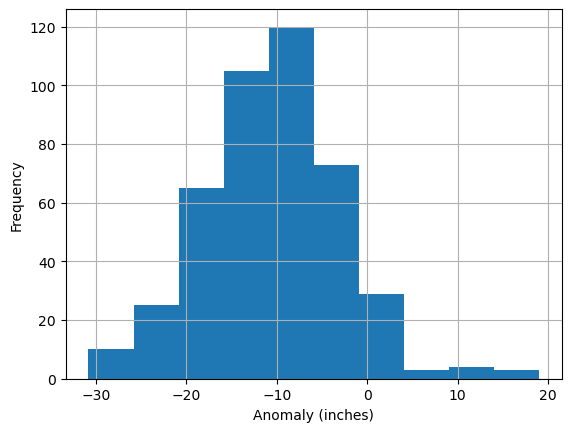

In [67]:
# fig, ax=plt.subplots()
# snow_depth_stats['anomoly'].hist()
# plt.xlabel('Anomaly (inches)')
# plt.ylabel('Frequency')
# plt.savefig('hist_2014_anom.jpeg')

<AxesSubplot: >

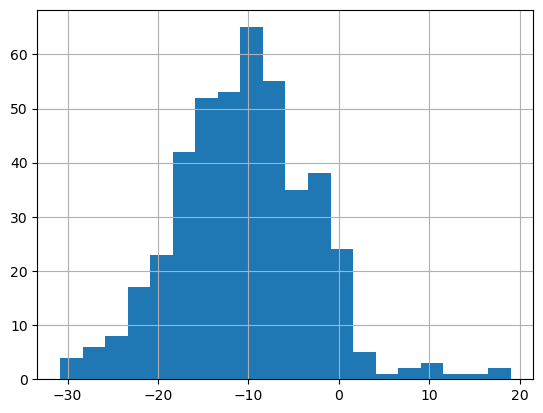

In [60]:
snwd_april1_anom_nan.iloc[0].hist(bins=20)

<AxesSubplot: >

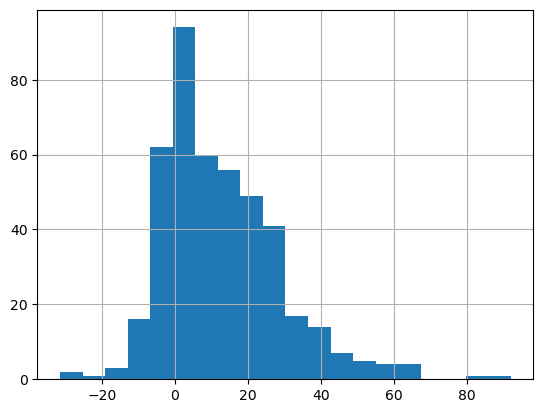

In [49]:
snwd_april1_anom_nan.iloc[2].hist(bins=20)

<AxesSubplot: >

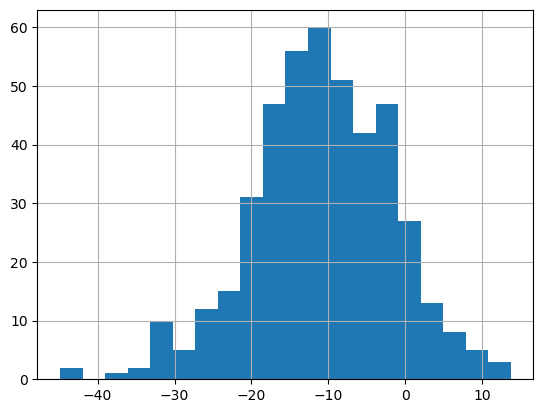

In [50]:
snwd_april1_anom_nan.iloc[3].hist(bins=20)

<AxesSubplot: >

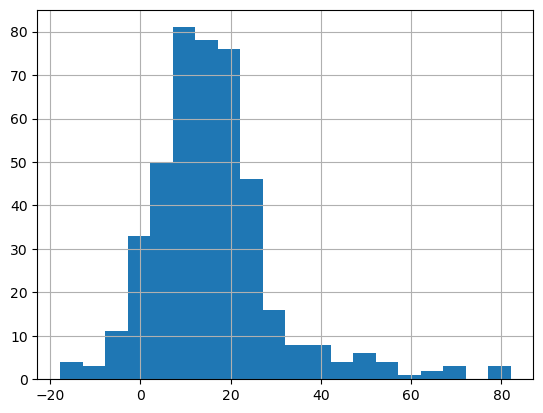

In [51]:
snwd_april1_anom_nan.iloc[4].hist(bins=20)

In [10]:
from matplotlib_scalebar.scalebar import ScaleBar

In [11]:
wa_bounds = (-124.733174, 45.543541, -116.915989, 49.002494)

In [12]:
western_bounds = (-124.733174, 31.332177, -102.041524, 49.002494)

In [13]:
western_boundary.to_crs('epsg:4326').bounds

,minx,miny,maxx,maxy
0,-124.733174,31.332177,-102.041524,49.002494


In [14]:
#List of all products hosted by OpenTopography GlobalDEM API
demtype_list = ["SRTMGL3", "SRTMGL1", "SRTMGL1_E", "AW3D30", "AW3D30_E", "SRTM15Plus"]

In [15]:
demtype = demtype_list[0]
demtype

'SRTMGL3'

In [16]:
base_url="https://portal.opentopography.org/API/globaldem?demtype={}&west={}&south={}&east={}&north={}&outputFormat=GTiff"

In [17]:
base_url.format(demtype, *western_bounds)

'https://portal.opentopography.org/API/globaldem?demtype=SRTMGL3&west=-124.733174&south=31.332177&east=-102.041524&north=49.002494&outputFormat=GTiff'

In [18]:
def get_OT_GlobalDEM(demtype, bounds, out_fn=None):
    if out_fn is None:
        out_fn = '{}.tif'.format(demtype)
    
    if not os.path.exists(out_fn):
        #Prepare API request url
        #Bounds should be [minlon, minlat, maxlon, maxlat]
        url = base_url.format(demtype, *bounds)
        print(url)
        #Get
        response = requests.get(url)
        #Should check for 200
        #Write to disk
        open(out_fn, 'wb').write(response.content)

In [19]:
out_fn = f"WesternUS_{demtype}.tif"
out_fn

'WesternUS_SRTMGL3.tif'

In [20]:
get_OT_GlobalDEM(demtype, western_bounds)

In [21]:
response = requests.get('https://portal.opentopography.org/API/globaldem?demtype=SRTMGL3&west=-124.733174&south=31.332177&east=-102.041524&north=49.002494&outputFormat=GTiff')

In [22]:
response

<Response [401]>

In [23]:
open(out_fn, 'wb').write(response.content)

162

In [117]:
!ls -lah $out_fn

-rw-r--r--  1 Hannah  staff   162B Mar 12 15:27 WesternUS_SRTMGL3.tif


In [24]:
!gdalinfo $out_fn

ERROR 4: `WesternUS_SRTMGL3.tif' not recognized as a supported file format.
gdalinfo failed - unable to open 'WesternUS_SRTMGL3.tif'.


In [29]:
from osgeo import gdal
import rasterio as rio
import rasterio.plot

In [30]:
src = rio.open('../../../Coursework/Spatial_stats/project/wus_dem_32613_5000m.tif')

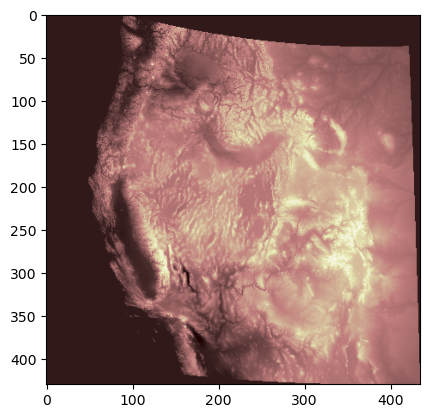

In [34]:
plt.imshow(src.read(1), cmap='pink')

In [31]:
dtm = src.read(1)

In [33]:
plot(dtm)

TypeError: 'module' object is not callable

In [123]:
!pwd

/Users/Hannah/Documents/Documents_Grad/Research/CorrelatedDomains/notebooks


# Old Code:

## Plot the means and some anomolies

In [34]:
Xs = western_snotel.geometry.x
Ys = western_snotel.geometry.y
april1_mean = np.nanmean(snwd_april1, axis=0)
# mean_df = pd.DataFrame({'april1_mean':april1_mean, 'lon': Xs, 'lat':Ys})
# mean_gdf = gpd.GeoDataFrame(
#     mean_df, geometry=gpd.points_from_xy(mean_df.lon, mean_df.lat), crs='epsg:4326')

In [20]:
snwd_april1_anom_2018 = snwd_april1_anom.loc[snwd_april1_anom.index.year == 2018] 
snwd_april1_anom_percent_2018 = snwd_april1_anom_percent.loc[snwd_april1_anom_percent.index.year == 2018]

NameError: name 'snwd_april1_anom_percent' is not defined

In [ ]:
mean_gdf['april1_anom_2018'] = snwd_april1_anom_2018.iloc[0]
mean_gdf['april1_anom_percent_2018'] = snwd_april1_anom_percent_2018.iloc[0]
mean_gdf['nan_count_years'] = snwd_april1.isnull().sum(axis=1)
mean_gdf['nan_count_column'] = snwd_april1.isna().sum()
#mean_gdf['nan_count_row'] = snwd_april1.isnull().sum(axis=1)

Text(91.97222222222221, 0.5, 'latitude')

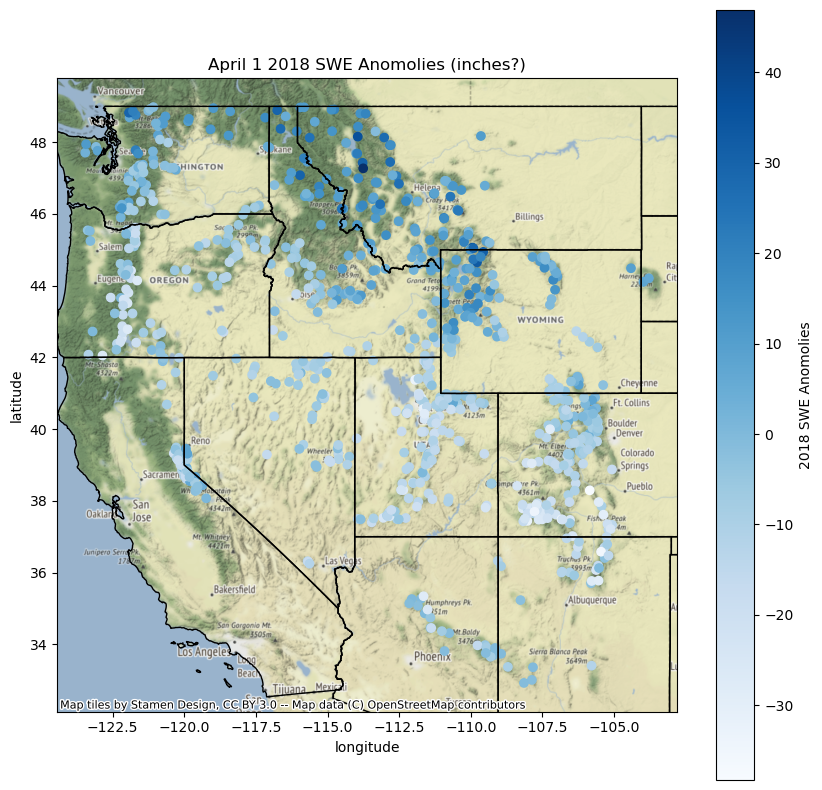

In [241]:
fig, ax = plt.subplots(1,1, figsize=(10,10))

mean_gdf.plot(ax=ax, column = 'april1_anom_2018', cmap='Blues', legend=True, legend_kwds={'label': "2018 SWE Anomolies",'orientation': "vertical"})
ctx.add_basemap(ax=ax, crs='epsg:4326', source=ctx.providers.Stamen.Terrain)
western_states.plot(ax=ax, facecolor='none');
plt.title('April 1 2018 SWE Anomolies (inches?)');
plt.xlabel('longitude')
plt.ylabel('latitude')

Text(91.97222222222221, 0.5, 'latitude')

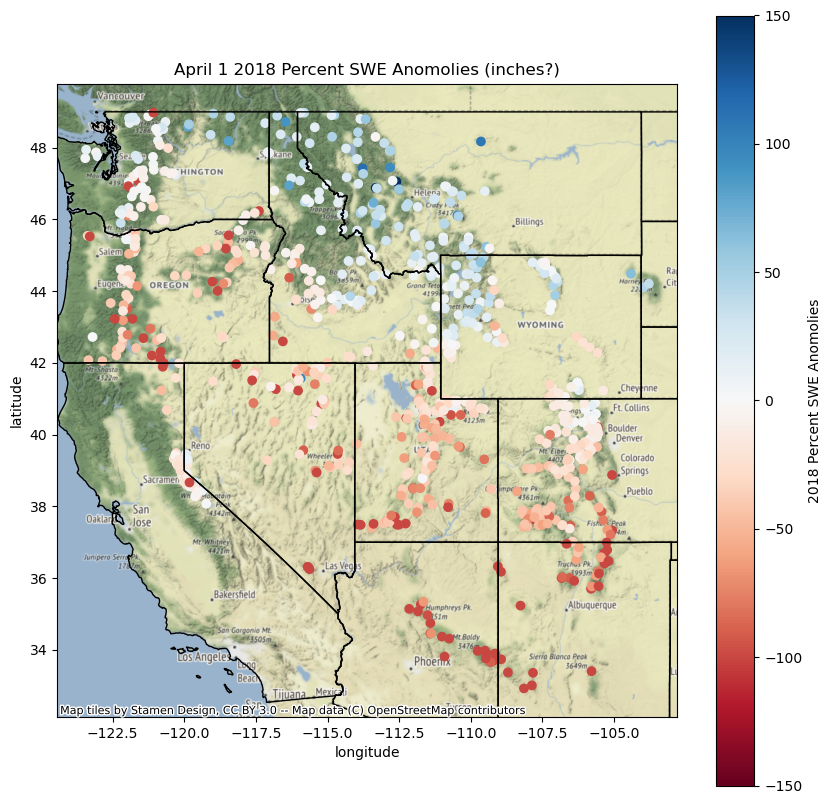

In [249]:
fig, ax = plt.subplots(1,1, figsize=(10,10))

mean_gdf.plot(ax=ax, column = 'april1_anom_percent_2018', cmap='RdBu', legend=True, legend_kwds={'label': "2018 Percent SWE Anomolies",'orientation': "vertical"}, vmin=-150, vmax=150)
ctx.add_basemap(ax=ax, crs='epsg:4326', source=ctx.providers.Stamen.Terrain)
western_states.plot(ax=ax, facecolor='none');
plt.title('April 1 2018 Percent SWE Anomolies (inches?)');
plt.xlabel('longitude')
plt.ylabel('latitude')